The goal of this notebook is to go through each step of the modularization process described in the paper "On decomposing a deep neural network into modules" by Pan & Rajan.

The source code was based on the [github page](https://github.com/rangeetpan/decomposeDNNintoModules) they used to document their work.

In [1]:
import os
import sys
import logging
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import keras
from keras.models import load_model
import pandas as pd

from utils.mnistutil import MNISTUitl
from utils.sliceutil3 import Slice
from keras.models import load_model

from utils.logger import setup_logger

sx = 28
sy = 28
path = "data/intermediate"

setup_logger('TI-I_FMNIST-3')
# from keras.models import load_model
# from datetime import datetime

accuracyCheck=[]
labs = [0,1,2,3,4,5,6,7,8,9]

# Functions

In [2]:
def concat_series(param, path):
    result = pd.DataFrame()
    for index, file in [(file.split('_')[0], file) for file in os.listdir(path) if param in file]:
        df = pd.read_csv(os.path.join(path, file))
        
        if type(df) == pd.core.frame.DataFrame:
            df = df.drop(columns=['Unnamed: 0']).assign(digit=index)
            result = pd.concat([result, df])
        else:
            df = df['0'].rename(index)
            result = pd.concat([result, df], axis=1)
        
    
    return result

def plot_neuron_weights(W, neuron, pad=0, subplot_sizex=10, subplot_sizey=10):
    fig, axes = plt.subplots(subplot_sizex, subplot_sizey, figsize=(20, 20))

    for i, ax in enumerate(axes.flat):
        W[W.neuron == (i+pad)][['digit', str(neuron)]].set_index('digit').plot(ax=ax)
        ax.set_title(f'Weight {i+pad}')
        ax.legend().remove()

    plt.tight_layout()  # Adjust the spacing between subplots
    plt.show()

def plot_neuron_weights_05xticks(W, neuron, pad=0):
    fig, axes = plt.subplots(10, 10, figsize=(20, 20))

    for i, ax in enumerate(axes.flat):
        W[W.neuron == (i+pad)][['digit', str(neuron)]].set_index('digit').plot(ax=ax)
        ax.set_title(f'Neuron {i+pad}')
        ax.legend().remove()
        # ax.set_xticks([0, 1, 2, 3, 4, 5])

    plt.tight_layout()  # Adjust the spacing between subplots
    plt.show()

def plot_diff_calc_model(alg_outputs, model_outputs, n_neurons:int = 49, fig_size=(15, 120)):
    fig, axs = plt.subplots(nrows=n_neurons, ncols=1, constrained_layout=True, figsize=fig_size)
    fig.suptitle("Differences between Algorithm's calculated output and the Model's output", fontsize=25)

    # clear subplots
    for ax in axs:
        ax.remove()

    # add subfigure per subplot
    gridspec = axs[0].get_subplotspec().get_gridspec()
    subfigs = [fig.add_subfigure(gs) for gs in gridspec]

    for row, subfig in enumerate(subfigs):
        subfig.suptitle(f'Neuron {row}', fontsize=20)

        # create 1x3 subplots per subfig
        axs = subfig.subplots(nrows=1, ncols=3, sharey=True)

        calc_output = alg_outputs[alg_outputs.neuron == row].output.reset_index(drop=True)
        actual_output = model_outputs[row]
        difference = (calc_output - actual_output)

        calc_output.plot(ax=axs[0])
        axs[0].set_title(f'Calc. Outputs')

        actual_output.plot(ax=axs[1])
        axs[1].set_title(f'Model Outputs')

        difference.plot(ax=axs[2])
        axs[2].set_title(f'Difference')

    plt.show()

def preprocess_execution_log_files(outputs:list = list(), initial_weights:list = list(), updated_weights:list = list()):
    if len(outputs) > 0:
        for idx, X in enumerate(outputs):
            X['output'] = X['0']
            X = X.reset_index(names=['neuron']).drop(columns=['0'])
            X.digit = X.digit.astype(int)
            X.sort_values(by=['digit', 'neuron'], inplace=True)
            outputs[idx] = X

    if len(initial_weights) > 0:
        for idx, W in enumerate(initial_weights):
            W_idx = pd.DataFrame(W).reset_index(names=['neuron'])
            W_idx.digit = W_idx.digit.astype(int)
            initial_weights[idx] = W_idx

    if len(updated_weights) > 0:
        for idx, D in enumerate(updated_weights):
            D_idx = D.reset_index(names=['neuron'])
            D_idx.digit = D_idx.digit.astype(int)
            D_idx.sort_values(by=['digit', 'neuron'], inplace=True)
            updated_weights[idx] = D_idx

    return outputs, initial_weights, updated_weights

# Loading the data and training the model

In [3]:
mn = MNISTUitl()
X, Y, x, y = mn.getdata2(0,0,sx,sy)
xt, yt, xT, yT = mn.trainData(X, Y, x,y,sx,sy,10,50)

x_train shape: (48000, 28, 28, 1)
(48000, 28, 28, 1) 48000 train samples (48000,)
8000 test samples
(48000,) (48000,)


# Understanding how it breaks a single module

In [4]:
j = 2

First, it gets the weights and biases from the model.

In [5]:
slicingModel=load_model('emnist.h5')
model=load_model('emnist.h5')

digit  = []
slc = Slice()
W1, W2, W3, W4, b1, b2, b3, b4 = slc.getweights(slicingModel)

In [6]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (Flatten)             (None, 784)               0         
                                                                 
 H1 (Dense)                  (None, 49)                38465     
                                                                 
 H2 (Dense)                  (None, 49)                2450      
                                                                 
 H3 (Dense)                  (None, 49)                2450      
                                                                 
 output (Dense)              (None, 10)                500       
                                                                 
Total params: 43,865
Trainable params: 43,865
Non-trainable params: 0
_________________________________________________________________


Three dense layers

Then, it gets the examples that belong to the module. In the code below, it sets apart only the images that belong to the specified class and that the corresponding model's output neuron was activated with more than 0.9. It is possible to say that these are the True Positives (TP), meaning only the samples from the desired label that our model guessed correctly-even though other neurons could have been activated with higher values.

In [7]:
digit_idxs = []
for i in range(0,len(yt)):
    if yT[i] == j and model.predict(xT[i:i+1])[0][j] >.9:
        digit.append(xT[i])
        digit_idxs.append(i)
digit = digit[0:1000]
digit_idxs = digit_idxs[:1000]

1/1 [==============================] - 0s 31ms/step


Observations:
- We can calculate this once, outside the for loop that the authors created.
- they are using the test samples. should they? How will they evaluate the model later?

In [8]:
digit

[array([[[0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00]],
 
        [[0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         [0.0000000e+00],
         

The variable digit contains the input values as arrays for all the true positives, regarding our module label.

# Concern Identification (CI)

Below, The authors perform the Concern Identification (CI) step of the approach.

- They go through each TP in the test set and update the weights and biases of the model, according to the output of the neurons.
    - If the output of a neuron is less than or equal to zero, the updated weight for the neuron is zero
    - If the output of a neuron is greater than zero
        - the updated weight gets the result of min(|model_weight|, updated_weight)
        - if the resulting updated weight is less than 0, then the updated weight is zero.
- The operation in lines 5 and 6 are done in order to not leave the module too sparse. 
    - If the last dense layer has less than 45 weights above 0, then the module is considered sparse


Observations:
- Why the min operation takes place? 
- How would different operations impact?
- Does the order of the TP matter?
- If the resulting model is sparse, then they reset the operation?

In [9]:
mc = 0
for x in xT[digit_idxs]:
    W1, W2, W3, W4, b1, b2, b3, b4= slc.modifyThroughInterSection(slicingModel,x, mc, sx,sy, debug=True)
    mc=mc+1
    if np.count_nonzero(slc.D4) < 45:
        logging.info(f"Output Layer's valid weights are below threshold! Reseting weights.")
        #print("Breaking at mc ", mc,np.count_nonzero(slc.D2))
        slc.first = True

In [10]:
d1 = concat_series('dd1', path)
print(f"Shape of d1: {d1.shape}")
d2 = concat_series('dd2', path)
print(f"Shape of d2: {d2.shape}")
d3 = concat_series('dd3', path)
print(f"Shape of d3: {d3.shape}")
d4 = concat_series('dd4', path)
print(f"Shape of d4: {d4.shape}")


X1 = concat_series('X1', path)
print(f"Shape of X1: {X1.shape}")
X2 = concat_series('X2', path)
print(f"Shape of X2: {X2.shape}")
X3 = concat_series('X3', path)
print(f"Shape of X3: {X3.shape}")
X4 = concat_series('X4', path)
print(f"Shape of X4: {X4.shape}")

D1 = concat_series('D1', path)
print(f"Shape of D1: {D1.shape}")
D2 = concat_series('D2', path)
print(f"Shape of D2: {D2.shape}")
D3 = concat_series('D3', path)
print(f"Shape of D3: {D3.shape}")
D4 = concat_series('D4', path)
print(f"Shape of D4: {D4.shape}")

W1,b1 = model.layers[1].get_weights()
W2,b2 = model.layers[2].get_weights()
W3,b3 = model.layers[3].get_weights()
W4,b4 = model.layers[4].get_weights()
W1 = np.vstack([W1])
W2 = np.vstack([W2])
W3 = np.vstack([W3])
W4 = np.vstack([W4])

Shape of d1: (35182, 2)
Shape of d2: (35182, 2)
Shape of d3: (35182, 2)
Shape of d4: (7180, 2)
Shape of X1: (35182, 2)
Shape of X2: (35182, 2)
Shape of X3: (35182, 2)
Shape of X4: (7180, 2)
Shape of D1: (562912, 50)
Shape of D2: (35182, 50)
Shape of D3: (35182, 50)
Shape of D4: (35182, 11)


In [11]:
(X1, X2, X3, X4), _, (D1, D2, D3, D4) = preprocess_execution_log_files(outputs=[X1, X2, X3, X4], updated_weights=[D1, D2, D3, D4])

In [12]:
outputs=[X1, X2, X3, X4]
initial_weights=[W1, W2, W3, W4]
updated_weights=[D1, D2, D3, D4]

## Digging Deep into the observations

In order to understand the questions raised, the operation was executed and the variables were saved at each step.

In this section, we read the resulting files and try to reason.

### Neurons Output

In [13]:
len(outputs)

4

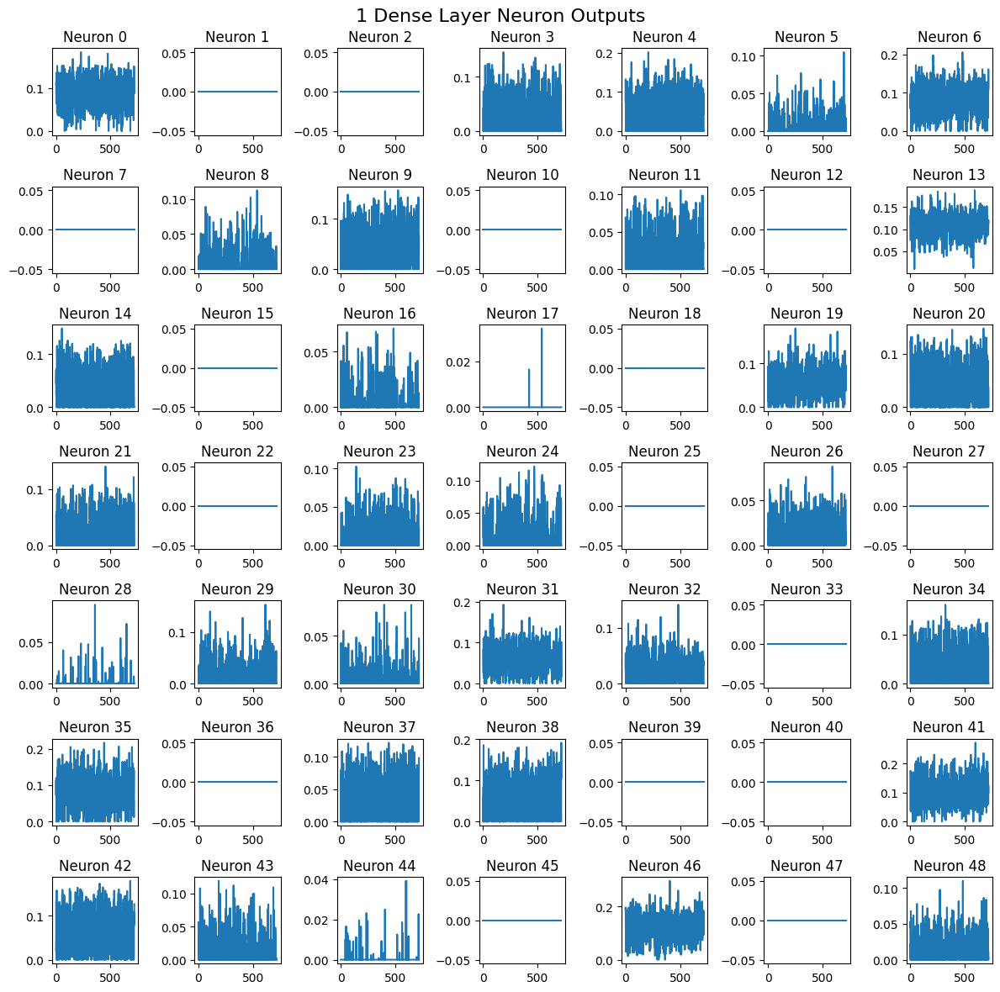

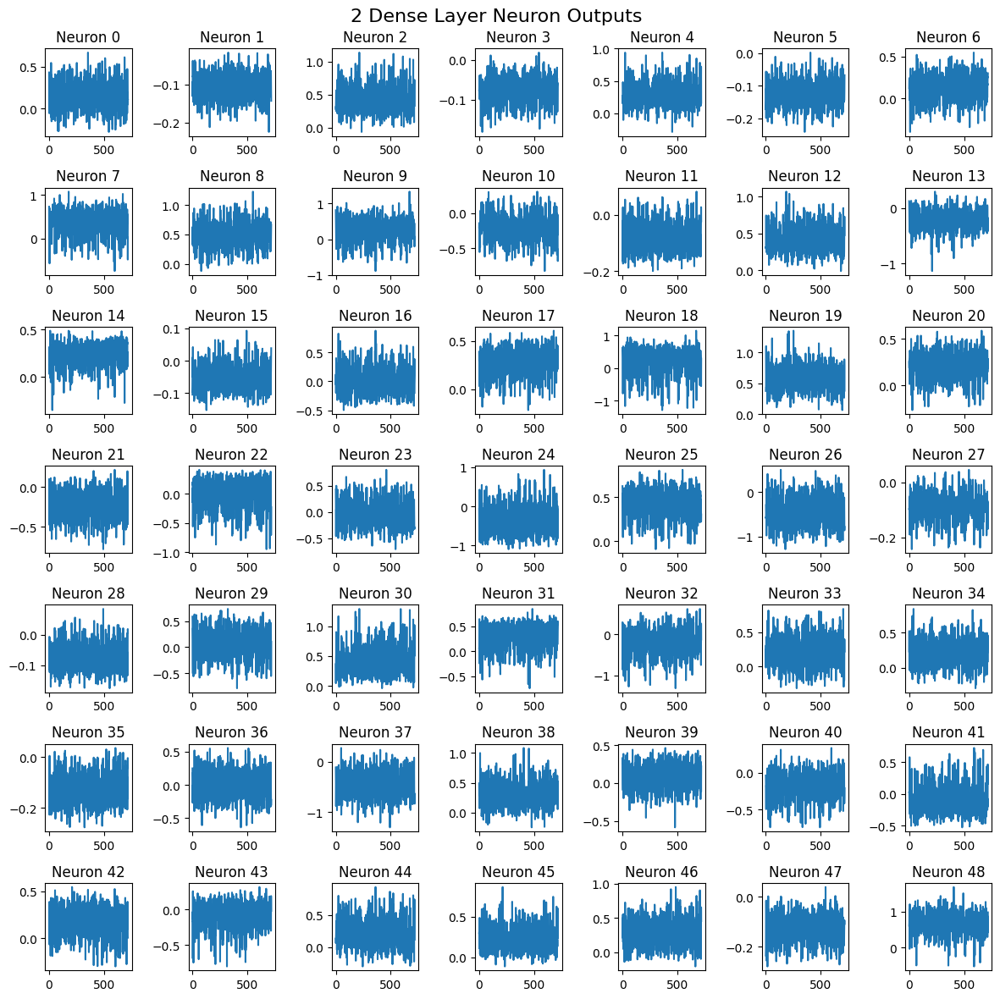

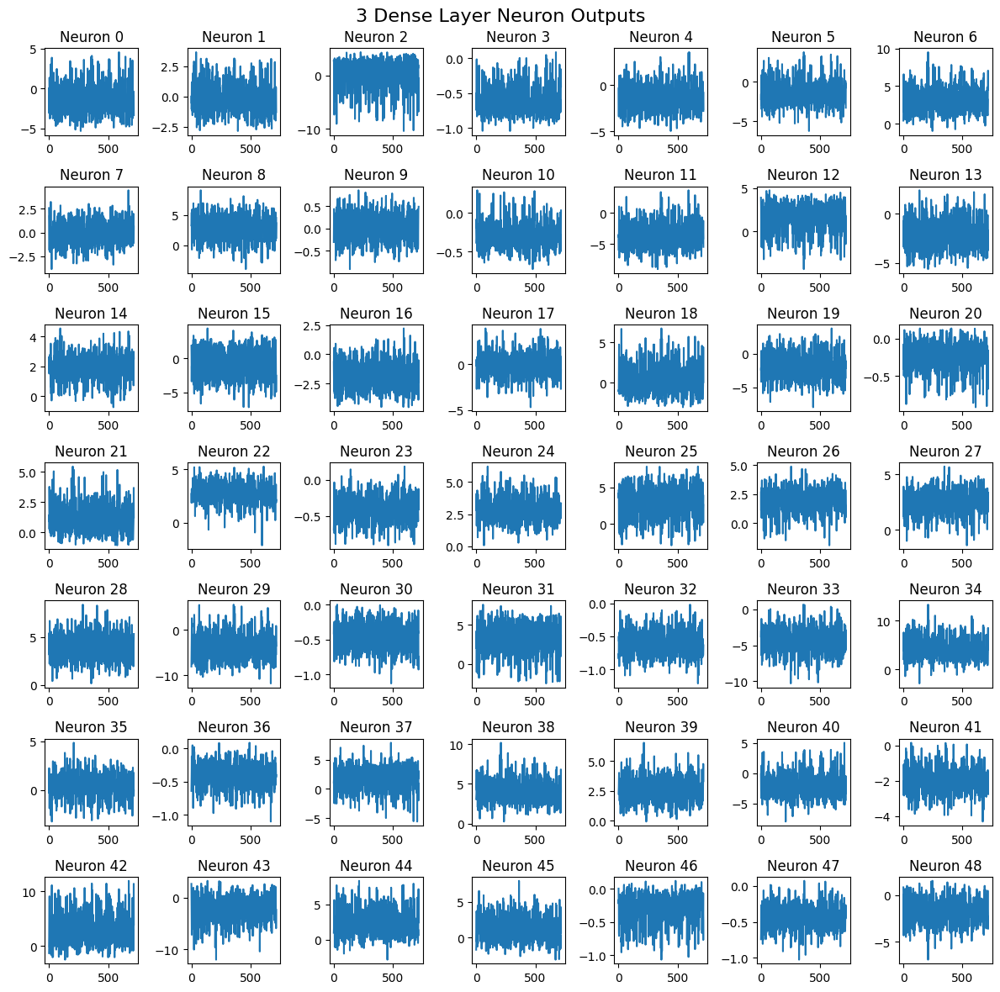

In [14]:
for idx, X in enumerate(outputs):
    if idx == len(outputs) - 1:
        continue

    fig, axes = plt.subplots(7, 7, figsize=(12, 12))

    for i, ax in enumerate(axes.flat):
        X[X.neuron == i].output.reset_index(drop=True).plot(ax=ax)
        ax.set_title(f'Neuron {i}')

    fig.suptitle(f"{idx + 1} Dense Layer Neuron Outputs", fontsize=16)
    plt.tight_layout()  # Adjust the spacing between subplots
    plt.show()

- Some neurons are not activated at all. But this happens only in the first dense layter
- Because of the ReLU function, no output value is below zero in the first layer. This doesn't happen for the other layers.
- All neurons in layers other than the first have values that include zero and negative ones. 

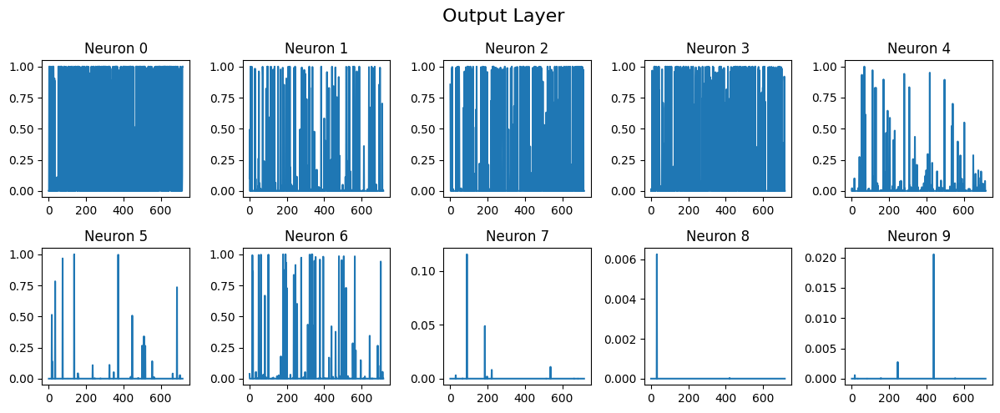

In [15]:
fig, axes = plt.subplots(2, 5, figsize=(12, 5))

for i, ax in enumerate(axes.flat):
    X4[X4.neuron == i].output.reset_index(drop=True).plot(ax=ax)
    ax.set_title(f'Neuron {i}')

fig.suptitle("Output Layer", fontsize=16)
plt.tight_layout()  # Adjust the spacing between subplots
plt.show()

Weirdly, several Neurons are heavily activated - not only 2. Maybe there is a problem with accuracy for this class.

In [16]:
from sklearn.metrics import accuracy_score, classification_report
pred=np.argmax(model.predict(xt),axis=1)
print(classification_report(pred,yt))

250/250 [==============================] - 1s 2ms/step
              precision    recall  f1-score   support

           0       0.91      0.89      0.90       823
           1       0.92      0.91      0.91       813
           2       0.94      0.92      0.93       809
           3       0.94      0.90      0.92       835
           4       0.90      0.93      0.91       771
           5       0.95      0.94      0.95       809
           6       0.86      0.92      0.89       748
           7       0.93      0.95      0.94       783
           8       0.96      0.92      0.94       836
           9       0.91      0.94      0.93       773

    accuracy                           0.92      8000
   macro avg       0.92      0.92      0.92      8000
weighted avg       0.92      0.92      0.92      8000



The accuracy is actually pretty good. As well as the precision and recall for class 2. 

The reasonable hypothesis is that the output of the algorithm is different from the model's outputs. This hypothesis will be dealt with later in this notebook.

## 1st Dense layer

### Regular Neuron

In [17]:
r_neuron = 13

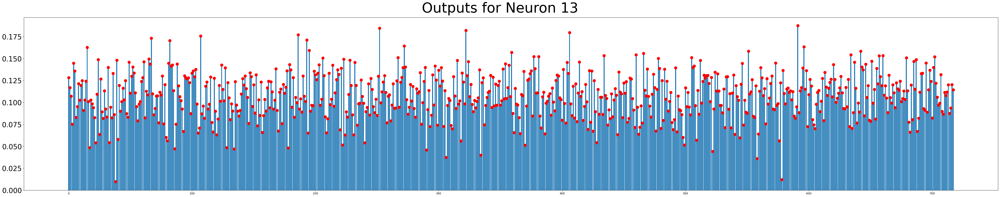

In [18]:
output_rn = X1[X1.neuron == r_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

plt.bar(output_rn.digit, output_rn.output)
plt.scatter(output_rn.digit, output_rn.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {r_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

In [19]:
output_rn.sort_values(by='output')

,output,digit
38,0.009816,38
578,0.012094,578
558,0.036088,558
306,0.037496,306
334,0.039818,334
...,...,...
186,0.177084,186
406,0.179501,406
322,0.182074,322
252,0.184431,252


We call this neuron 'regular' because it does not output zero at any point.

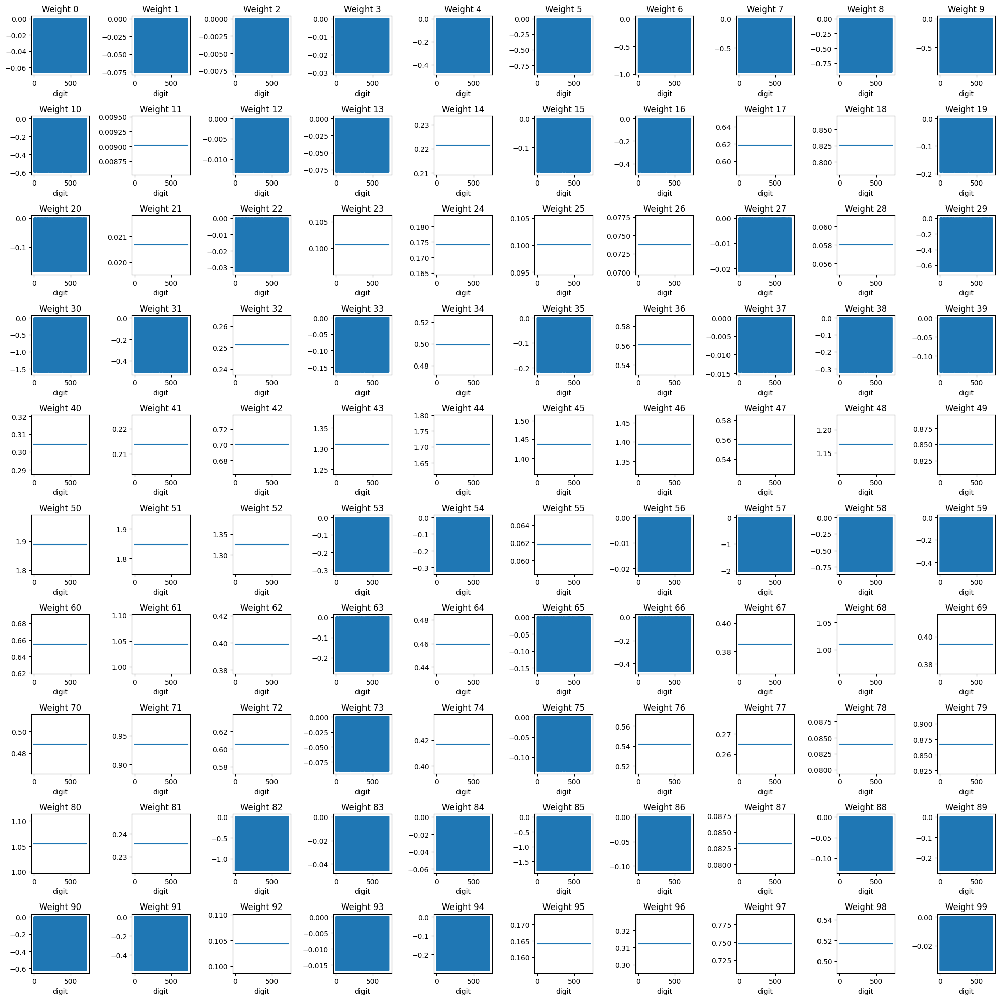

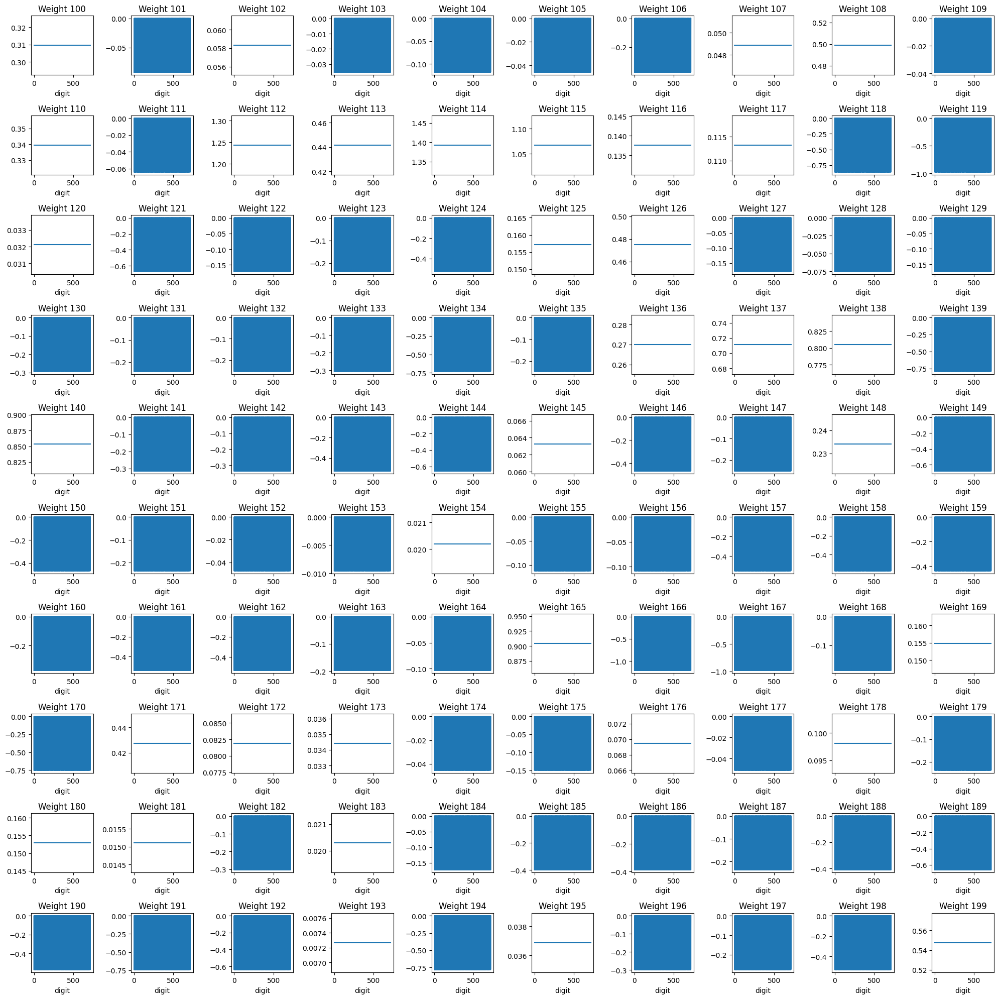

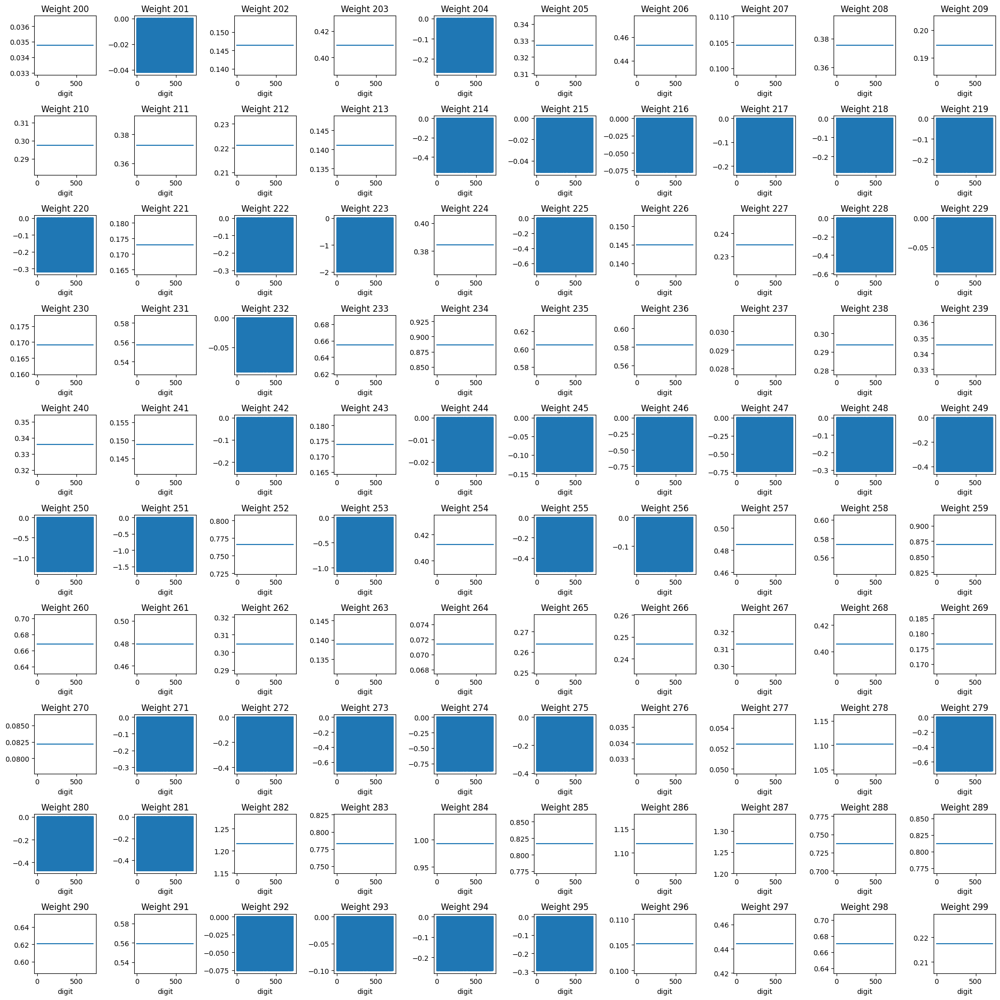

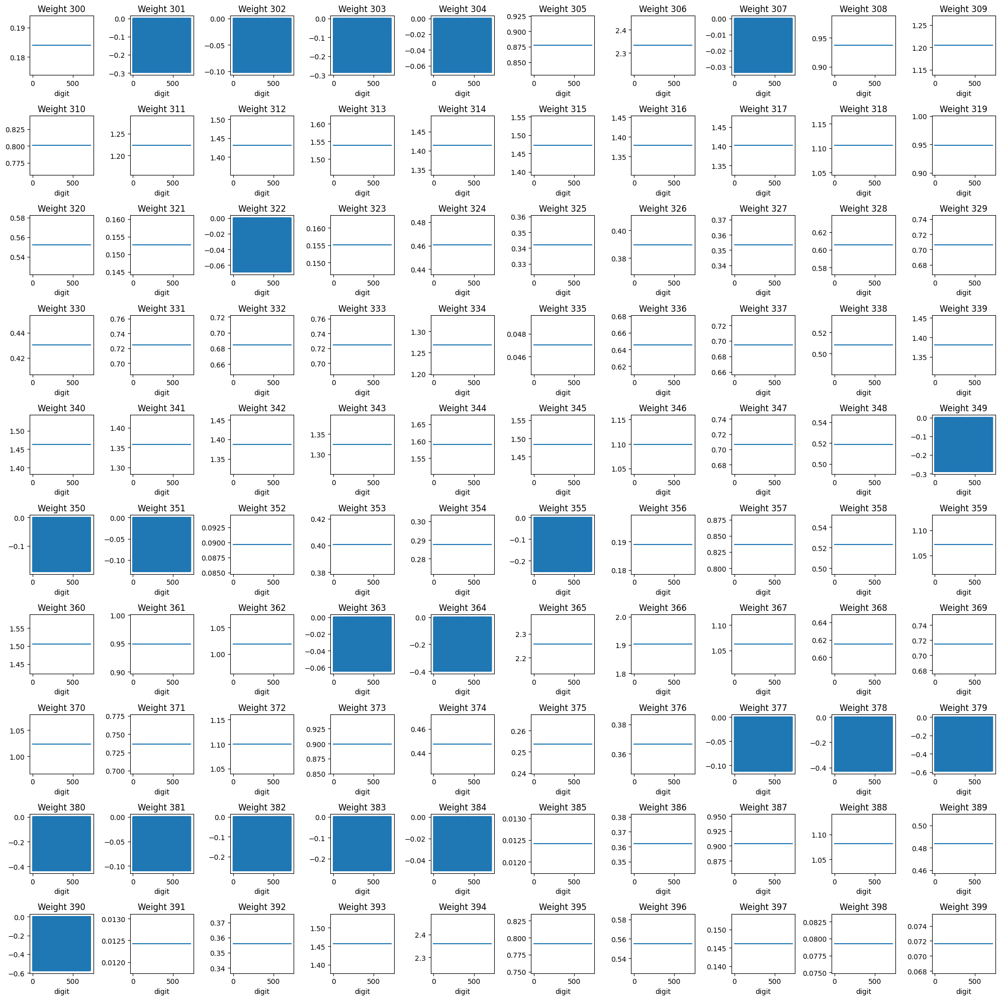

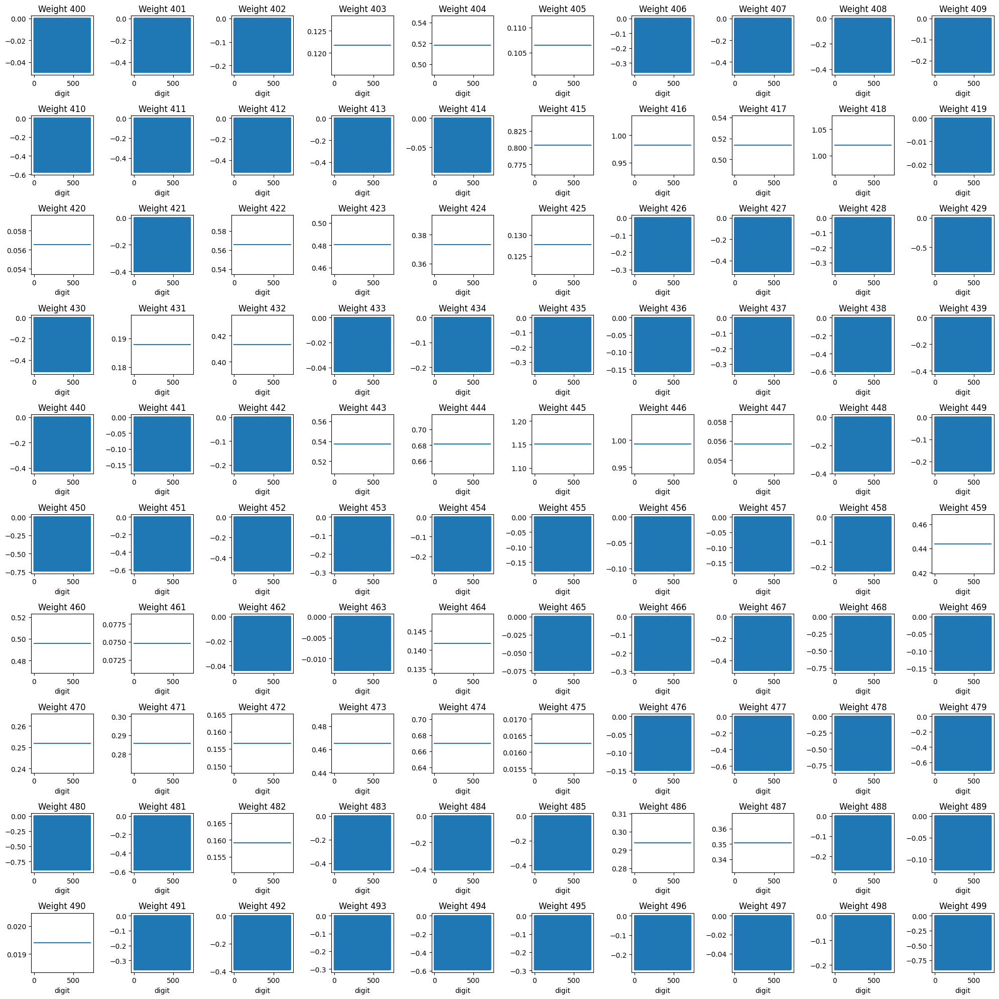

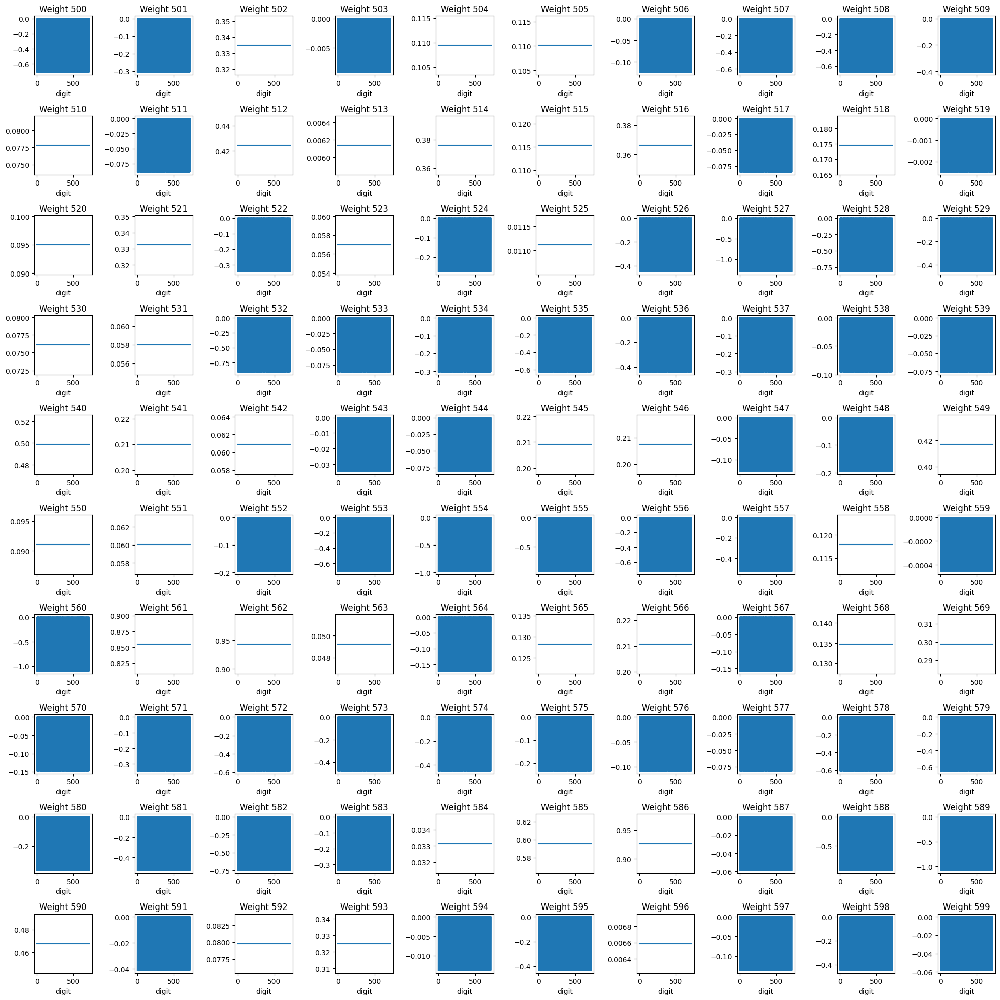

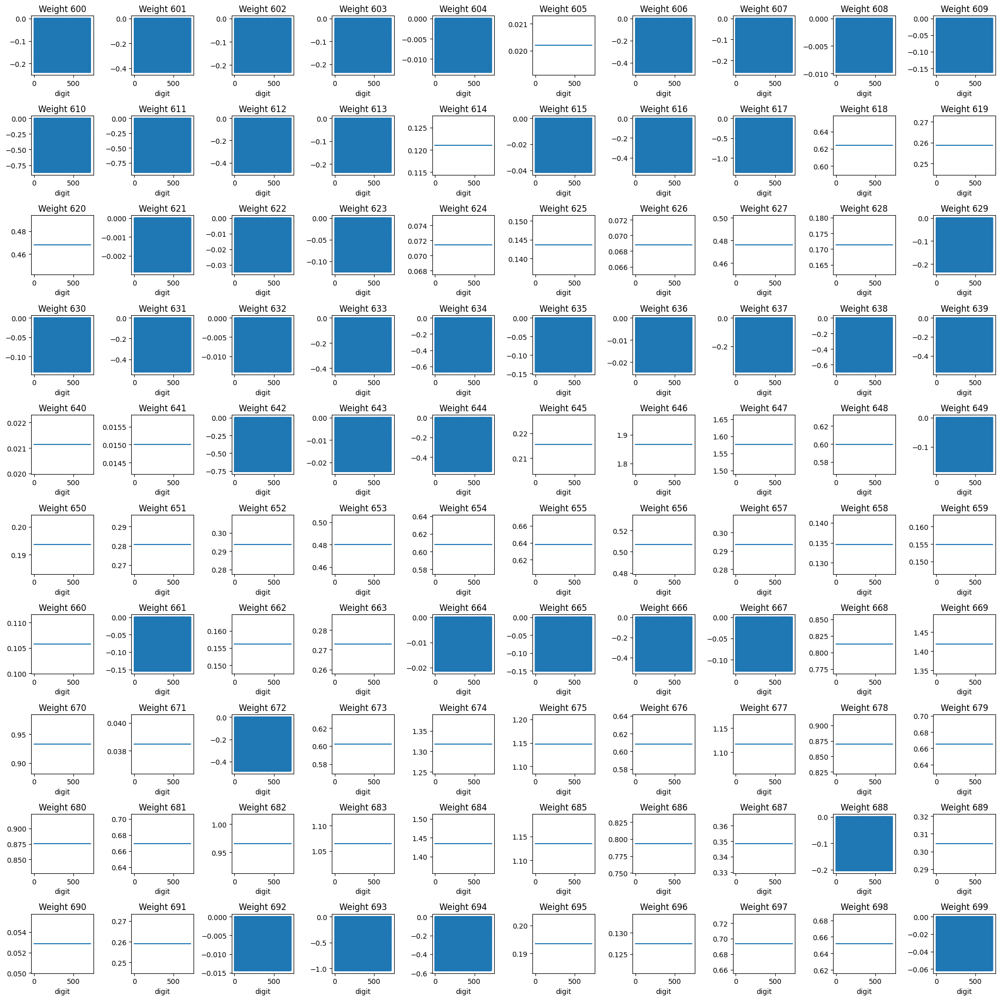

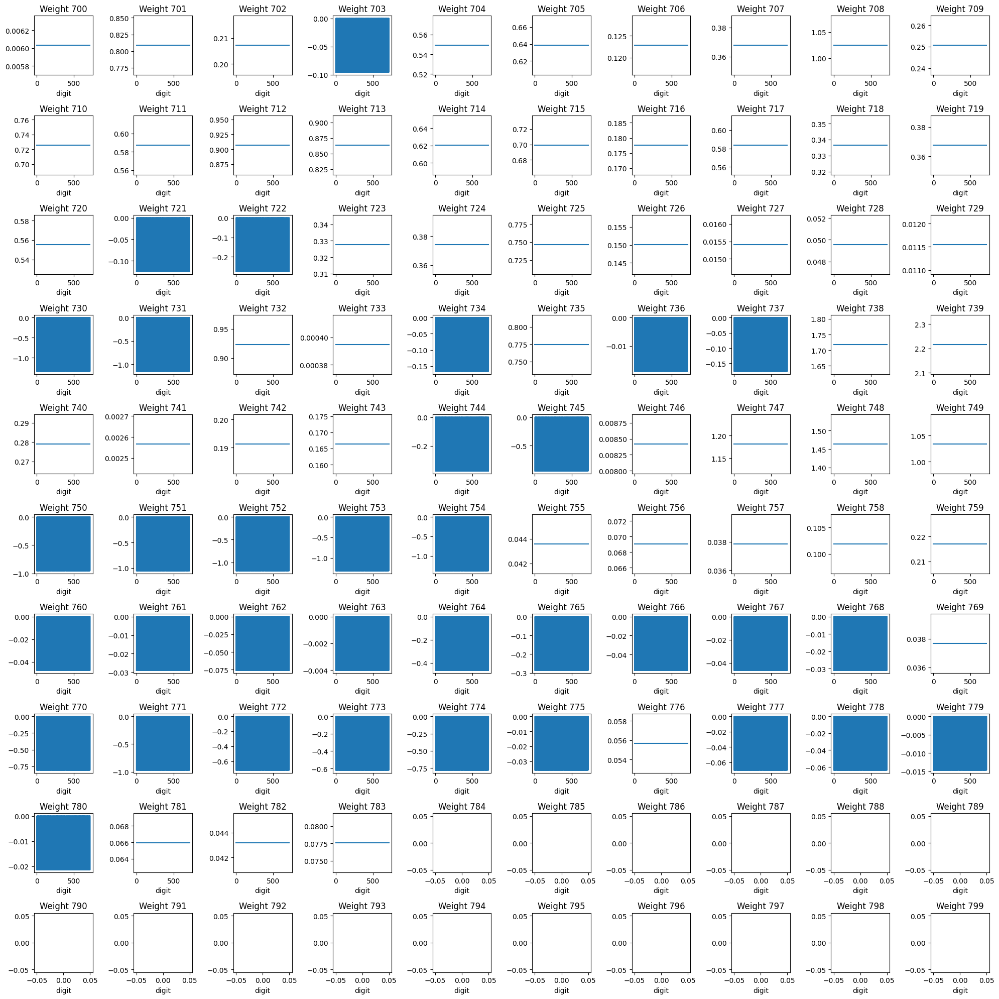

In [20]:
plot_neuron_weights(D1, r_neuron)
plot_neuron_weights(D1, r_neuron, pad=100)
plot_neuron_weights(D1, r_neuron, pad=200)
plot_neuron_weights(D1, r_neuron, pad=300)
plot_neuron_weights(D1, r_neuron, pad=400)
plot_neuron_weights(D1, r_neuron, pad=500)
plot_neuron_weights(D1, r_neuron, pad=600)
plot_neuron_weights(D1, r_neuron, pad=700)

- All the weights above 0 are kept unchanged.
- Differently from the algorithm for one layer, in case of negative weights, the updated weight keep switching between the model's weight and zero.
    - The max/min operation might be responsible for it.
    - If we change the order, would the weights have different values?

#### Looking closer at one weight

In [21]:
ex_weight = 0

<Axes: xlabel='digit'>

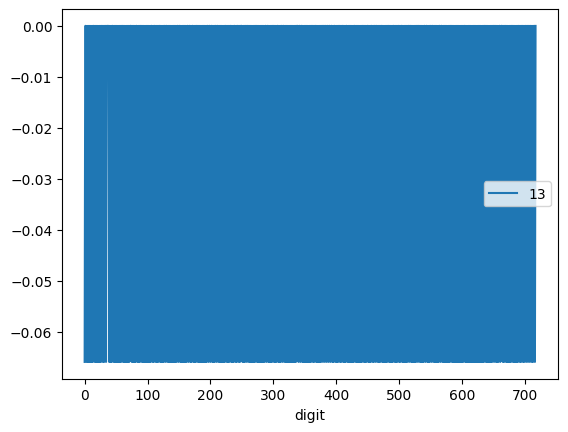

In [22]:
D1[D1.neuron == ex_weight][['digit', str(r_neuron)]].set_index('digit').plot()

In [33]:
sparse_th = 45

In [34]:
example = (D1[D1.neuron == ex_weight]
            .filter(['digit', str(r_neuron)])
            .set_index('digit')
            .rename(columns={str(r_neuron):'updated_weight'})
            .join(  # adding the output of the neuron
                X1[(X1.neuron == r_neuron)]
                .drop(columns='neuron')
                .set_index('digit')
            )
            .join(  # nonzero weights in the output layer
                D4
                .drop(columns=['neuron'])
                .groupby('digit')
                .apply(pd.DataFrame.drop, columns=['digit'])
                .groupby('digit')
                .apply(np.count_nonzero)
                .map(lambda x: 1 if x < sparse_th else 0)
                .rename('sparse_weights')
            )
        )

In [35]:
example.head(60)

,updated_weight,output,sparse_weights
digit,,,
0,-0.065907,0.128262,0
1,0.000000,0.116866,0
2,0.000000,0.107099,1
3,-0.065907,0.075126,0
4,0.000000,0.144591,1
5,-0.065907,0.135762,0
6,0.000000,0.082901,1
7,-0.065907,0.095236,0
8,0.000000,0.121361,1


The weights are reset for several samples. By looking at the log file, those are exactly the samples where the flag 'first' is set.
- This flag is reset whenever ```np.count_nonzero(slc.D4) < 45```. The authors say that this happens whenever the selected weights are few, below a threshold (45 in this case). They check only the output layer. To verify that, we created a column at the right that indicates whenever the 'valid' weights in the output layer are below the threshold.
- What would happen if the last execution ended up with 0 'valid' weights? as we see in the table below, the weights are reset only in the next iteration. If the last iteration ends with 0 weights, like what happens in digits 2, 10 and 12, we would end up with zero weights in the last layer.

In [36]:
nonzeros = pd.DataFrame()
nonzeros['layer_1'] = D1.drop(columns=['neuron']).groupby('digit').apply(pd.DataFrame.drop, columns=['digit']).groupby('digit').apply(np.count_nonzero)
nonzeros['layer_2'] = D2.drop(columns=['neuron']).groupby('digit').apply(pd.DataFrame.drop, columns=['digit']).groupby('digit').apply(np.count_nonzero)
nonzeros['layer_3'] = D3.drop(columns=['neuron']).groupby('digit').apply(pd.DataFrame.drop, columns=['digit']).groupby('digit').apply(np.count_nonzero)
nonzeros['layer_4'] = D4.drop(columns=['neuron']).groupby('digit').apply(pd.DataFrame.drop, columns=['digit']).groupby('digit').apply(np.count_nonzero)
nonzeros.head(60)

,layer_1,layer_2,layer_3,layer_4
digit,,,,
0,17248,1617,1225,196
1,7761,374,418,72
2,4924,171,240,0
3,15680,1225,1127,49
4,4400,182,304,25
5,14896,1470,1176,98
6,5401,286,347,24
7,14896,1372,1176,147
8,5720,280,326,22


- We thought of analyzing the decay of weights given the chain of inputs, but the initial weights are kept unchanged throughout the algorithm. The updated weights are only assigned to the model after the algorithm's execution.

#### Analysis of the resulting weights

In [42]:
post_ci_df_n13 = pd.DataFrame(W1)[r_neuron].rename('initial_weights').reset_index(drop=True).to_frame().reset_index(names='input_layer_neuron')
post_ci_df_n13['valid_initial_weights'] = post_ci_df_n13.initial_weights.map(lambda x: 0 if x <= 0 else 1)
post_ci_df_n13['updated_weights'] = D1[D1.digit == D1.digit.max()][str(r_neuron)].rename('updated_weights').reset_index(drop=True)
post_ci_df_n13['valid_updated_weights'] = post_ci_df_n13.updated_weights.map(lambda x: 0 if x == 0 else 1)

Text(0.5, 1.0, 'Weight Update')

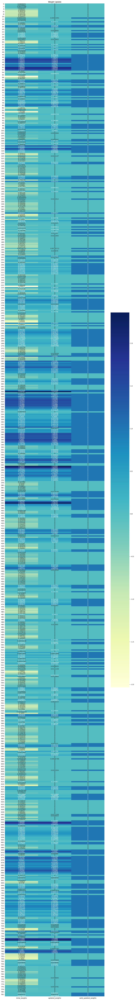

In [43]:
plt.figure(figsize=(15,120))
sns.heatmap(post_ci_df_n13[['initial_weights', 'updated_weights', 'valid_updated_weights']], annot=True, cmap='YlGnBu', fmt="g")
plt.title('Weight Update')

### Nonactivated Neuron

In [44]:
na_neuron = 10

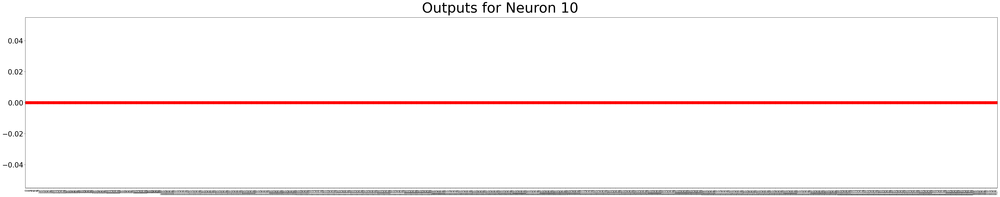

In [45]:
output_na = X1[X1.neuron == na_neuron].output.reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

# output_rn.plot(ax=axes, color='red')
output_na.plot(kind='bar', ax=axes)
plt.scatter(output_na.index, output_na.values, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {na_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

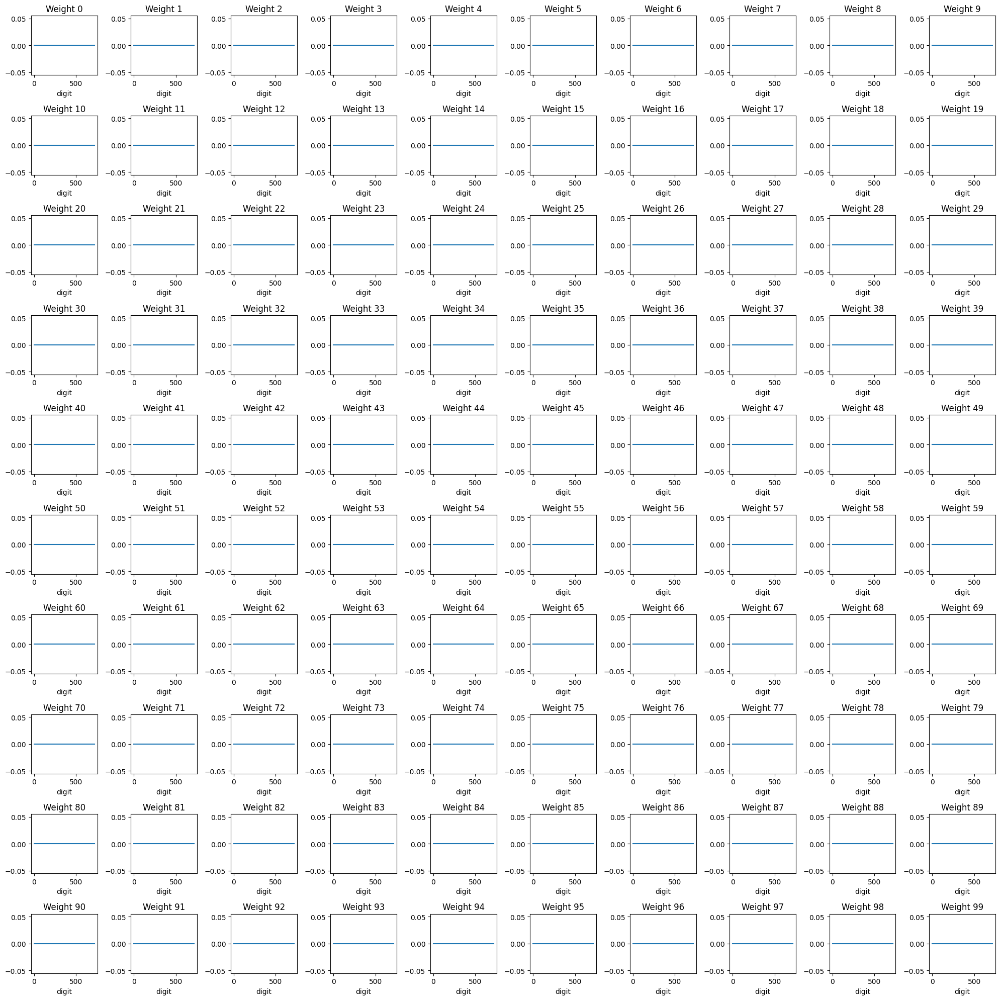

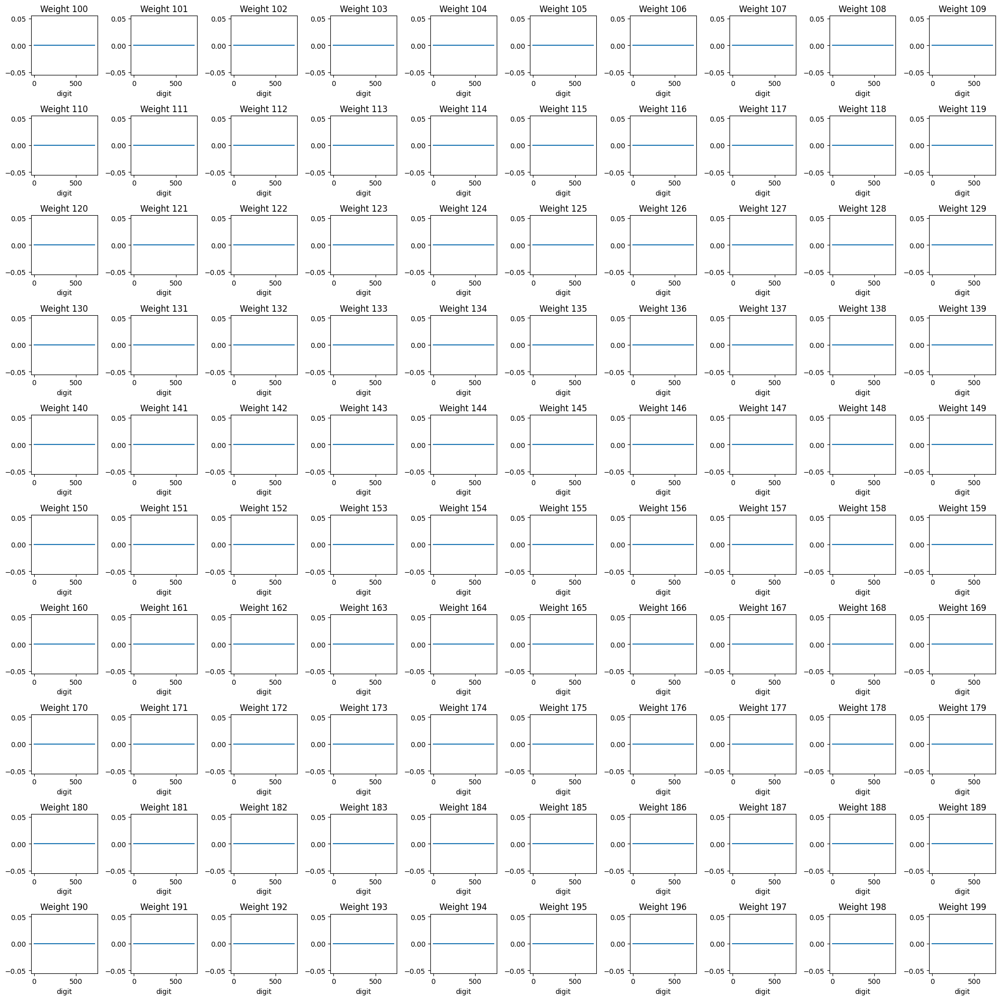

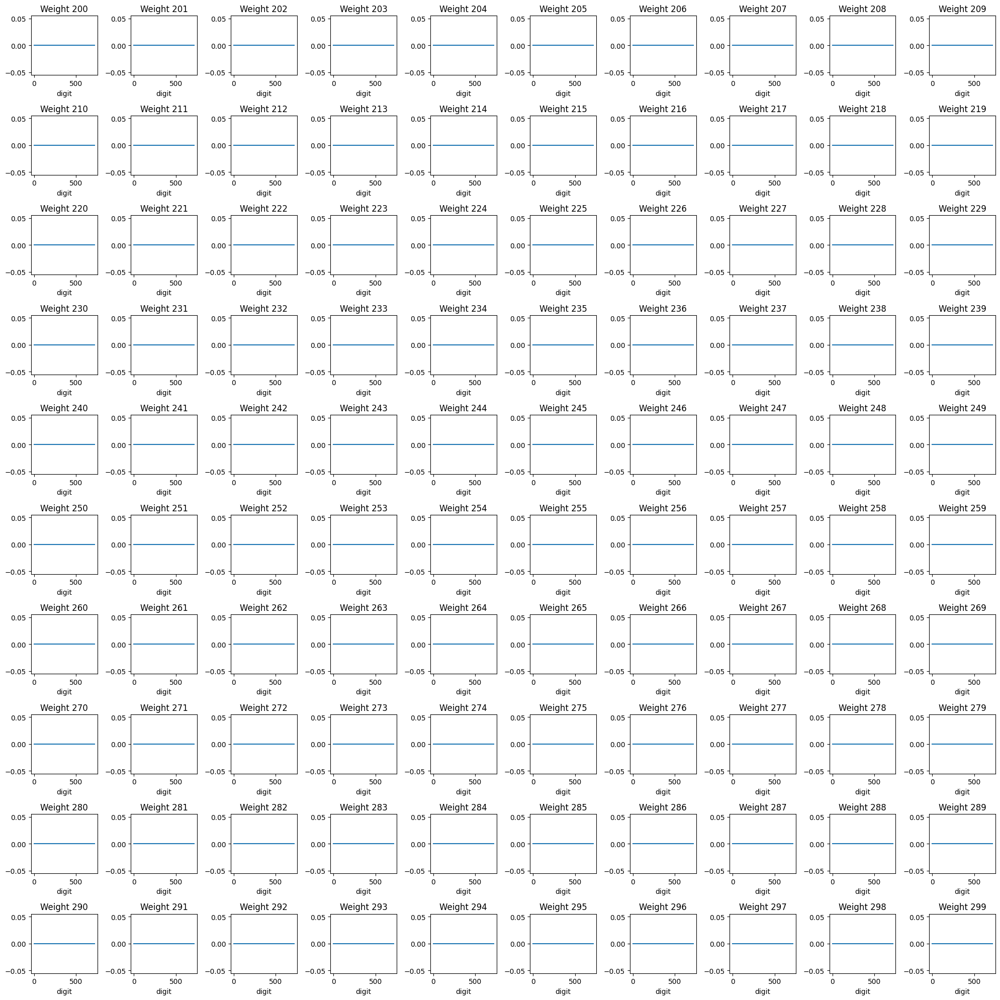

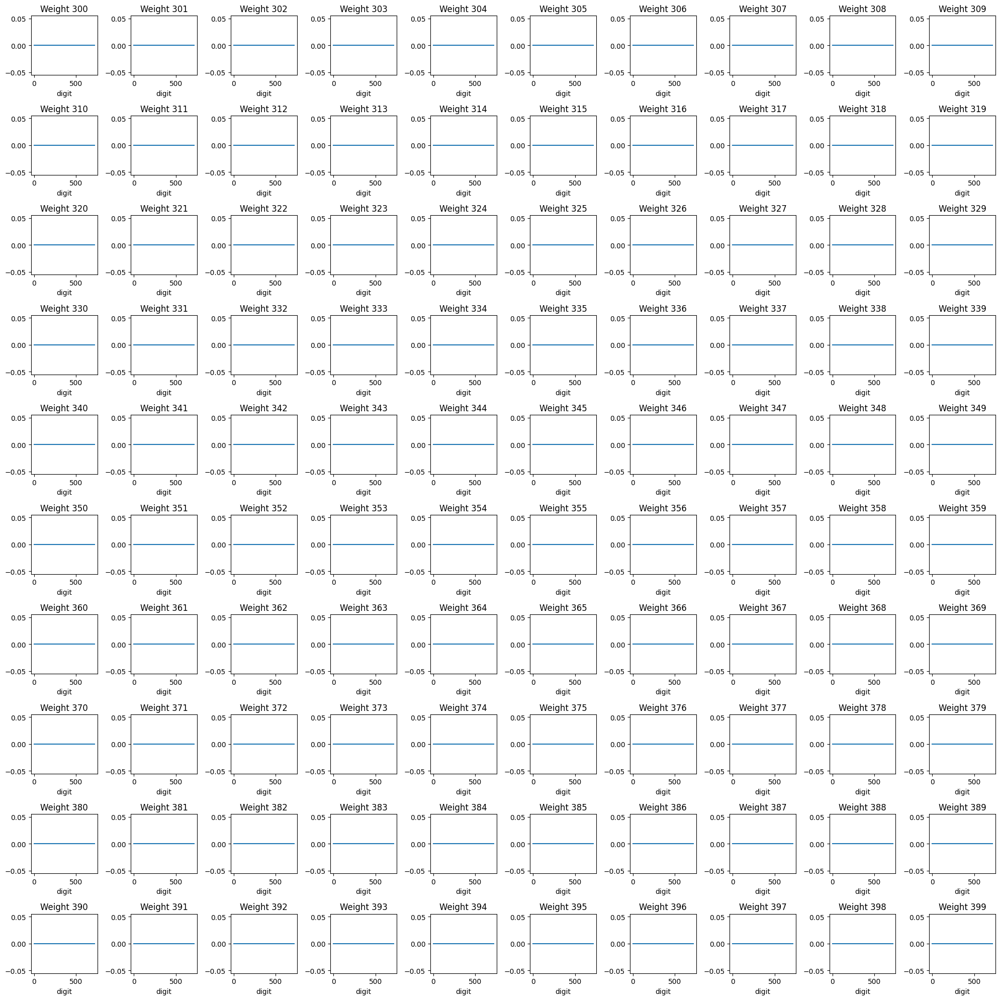

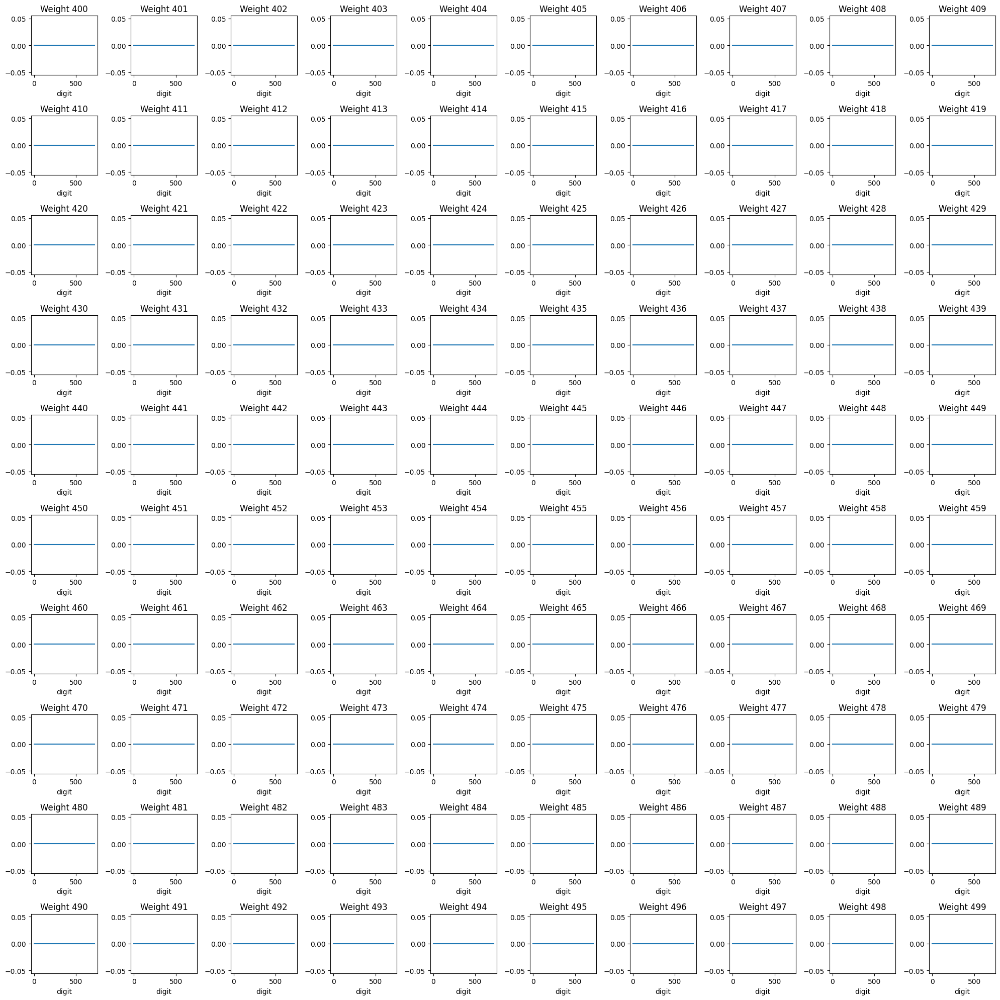

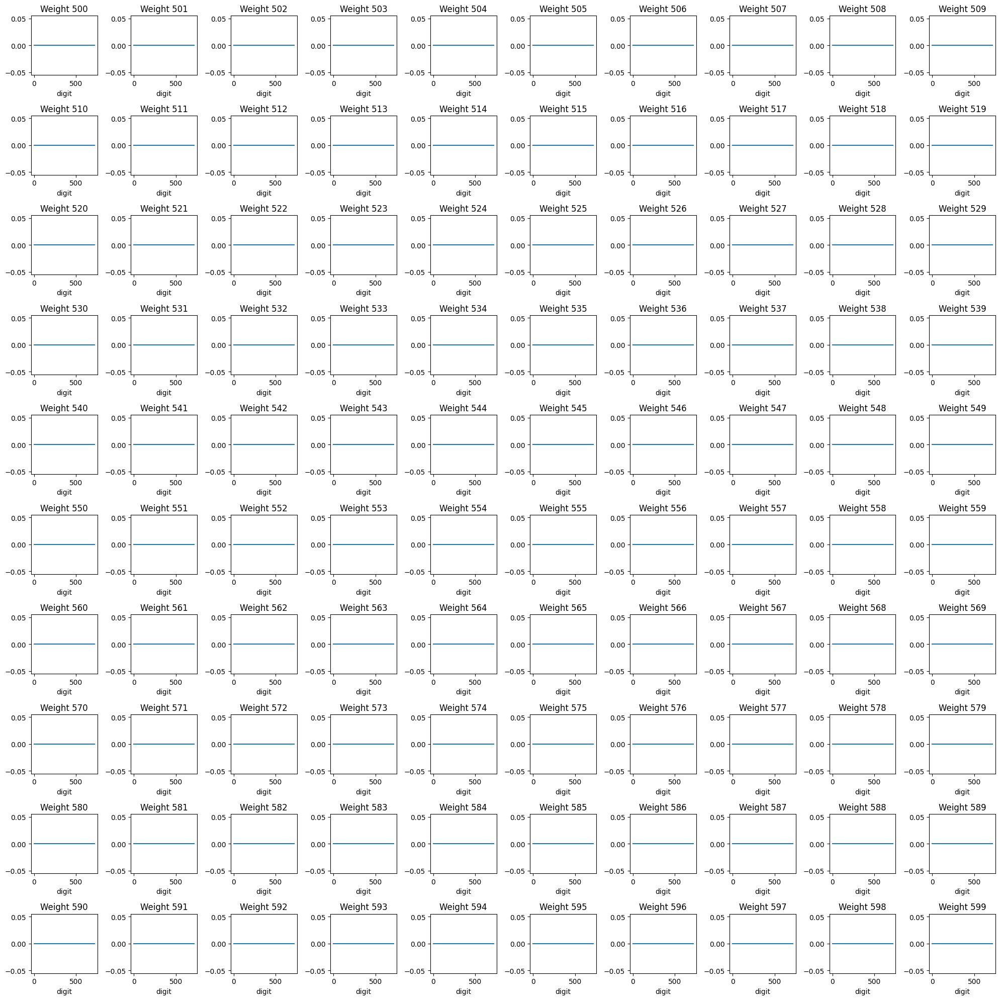

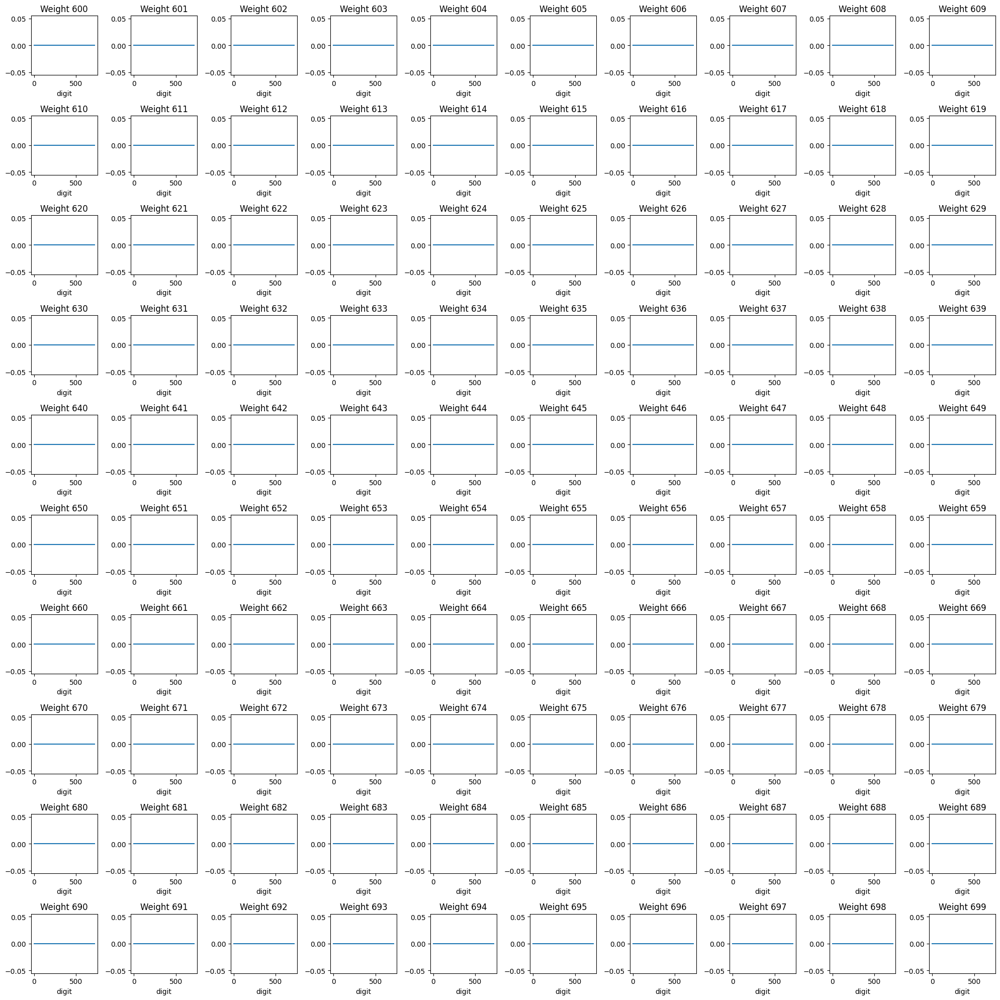

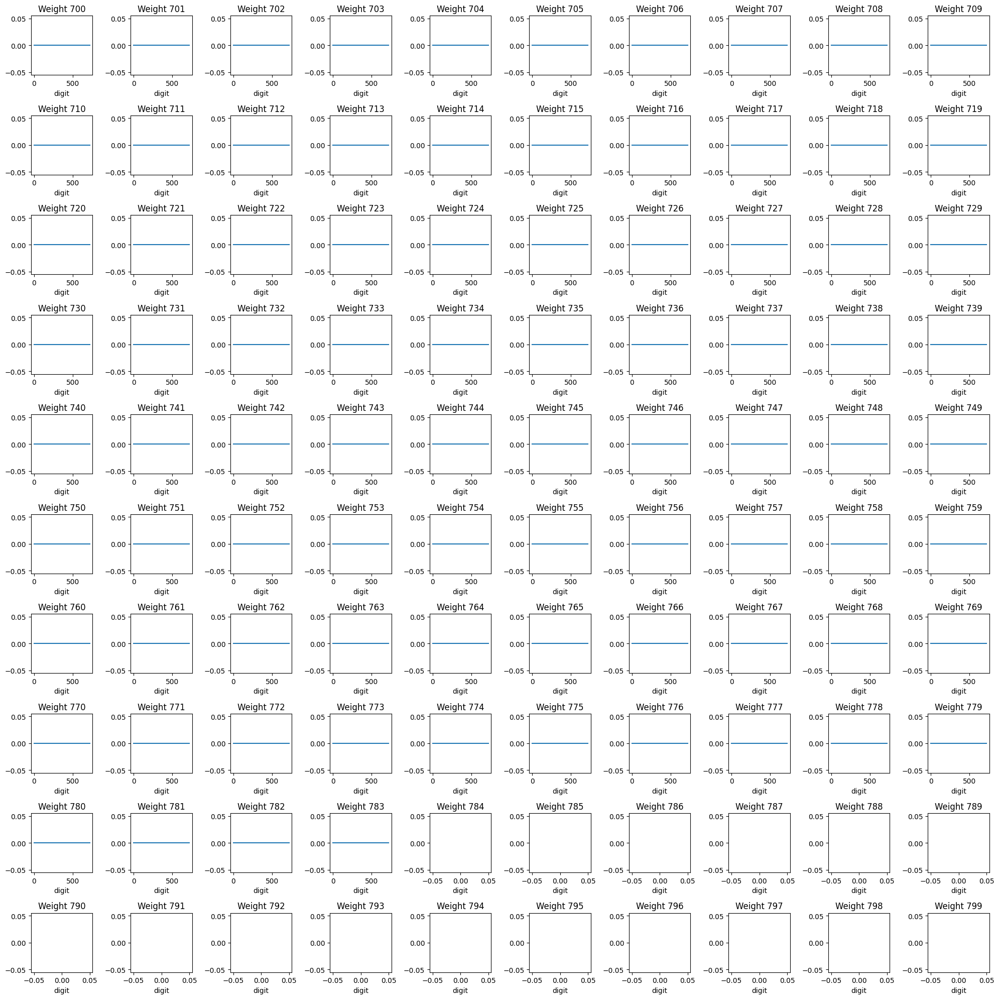

In [46]:
plot_neuron_weights(D1, na_neuron)
plot_neuron_weights(D1, na_neuron, pad=100)
plot_neuron_weights(D1, na_neuron, pad=200)
plot_neuron_weights(D1, na_neuron, pad=300)
plot_neuron_weights(D1, na_neuron, pad=400)
plot_neuron_weights(D1, na_neuron, pad=500)
plot_neuron_weights(D1, na_neuron, pad=600)
plot_neuron_weights(D1, na_neuron, pad=700)

All of the weights of this neuron are zero, which seems really weird. Below, I'll check if the original weights of the model are also zero. 

In [47]:
pd.DataFrame(W1).reset_index(names=['neuron'])[na_neuron]

0      0.015007
1      0.015604
2     -0.034672
3      0.048207
4     -0.008361
         ...   
779    0.019763
780    0.071384
781    0.023121
782   -0.037376
783   -0.066384
Name: 10, Length: 784, dtype: float32

In [49]:
D1[str(na_neuron)].sum()

0.0

Initially, the updated weights are set to zero and change if the first output is not zero.

By looking at the code, if the output of the neuron is zero, then the updated weights (D) and biases are set to zero. Since the first output and all the other ones are zero, the resulting weights are also zero.
- This is a clear indicator that these nodes should be removed from the modules.

### Neurons with Outputs that hit zero

In [53]:
hz_neuron = 46

In [55]:
X1[X1.neuron == hz_neuron].sort_values('output')

,neuron,digit,output
10434,46,291,0.000000
11169,46,304,0.000000
14305,46,362,0.000000
11316,46,307,0.010337
7102,46,22,0.013420
...,...,...,...
9356,46,271,0.241916
6661,46,221,0.246515
31504,46,679,0.253935
20822,46,482,0.260400


This neuron hits zero in digits 291, 304 and 362 -- only later in the execution, making it easier to see the changes.

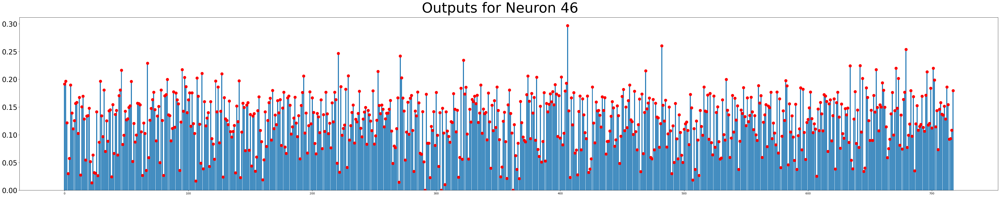

In [57]:
output_hz = X1[X1.neuron == hz_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

# output_rn.plot(ax=axes, color='red')
# output_hz.plot(kind='bar', ax=axes)
plt.bar(output_hz.digit, output_hz.output)
plt.scatter(output_hz.digit, output_hz.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {hz_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

This is a very active neuron.

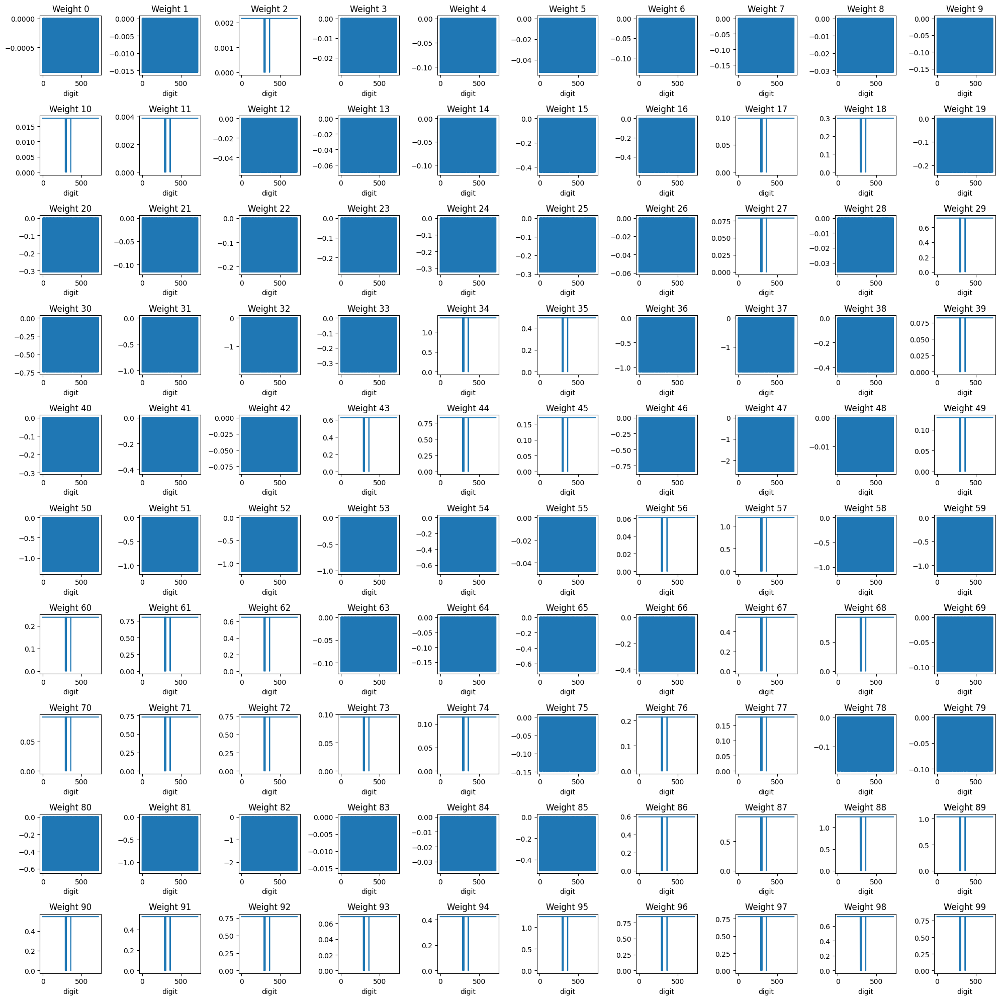

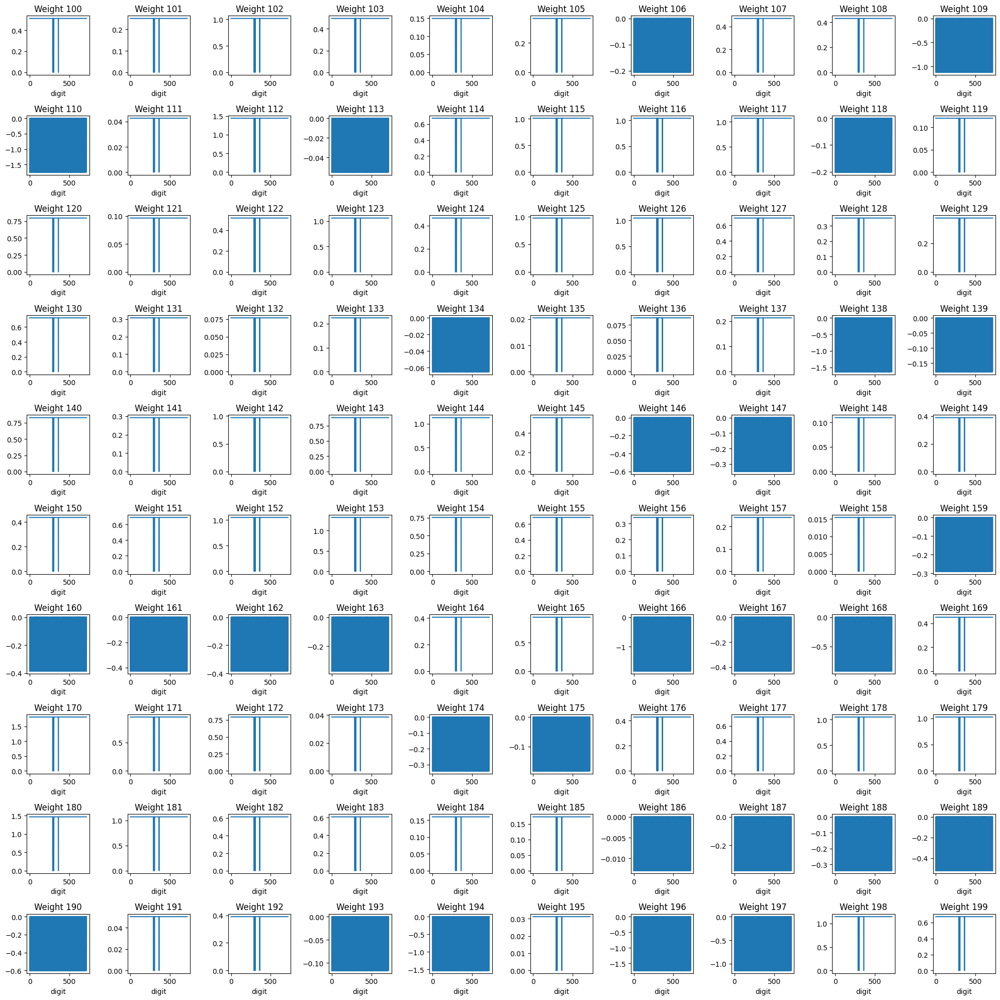

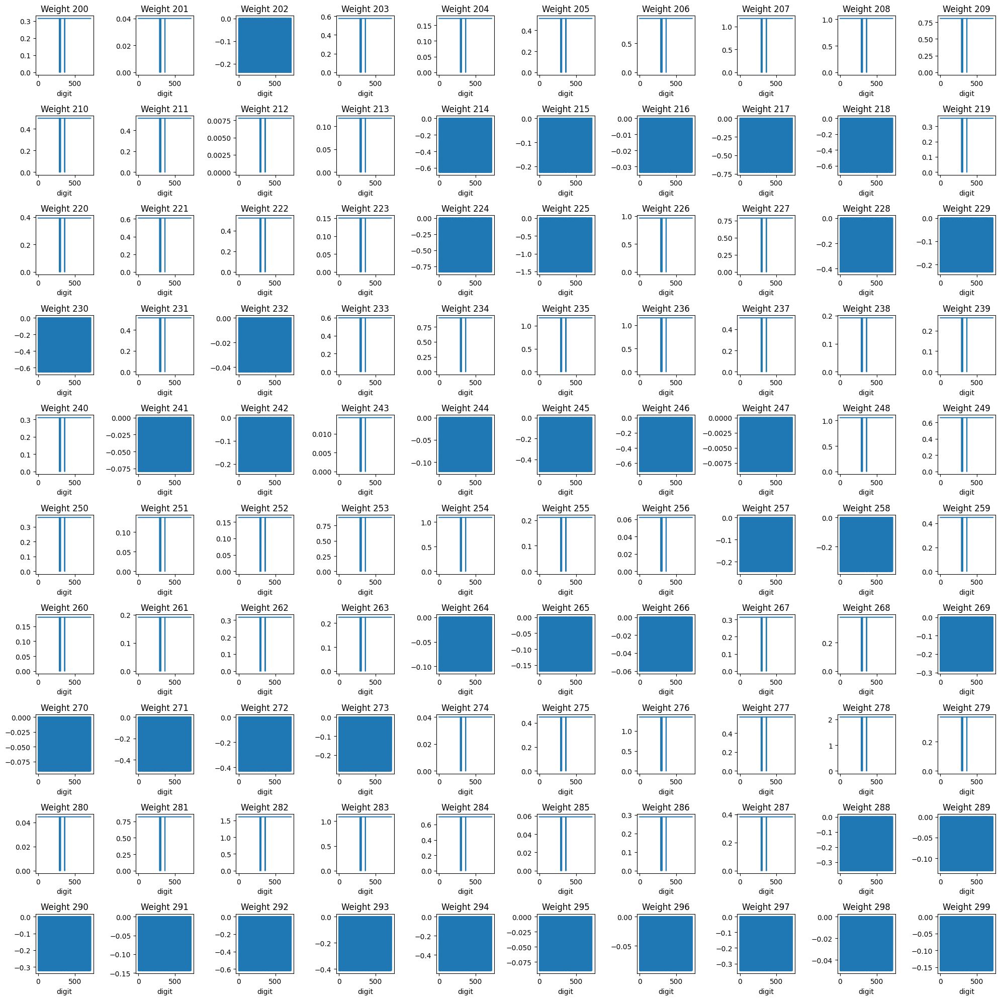

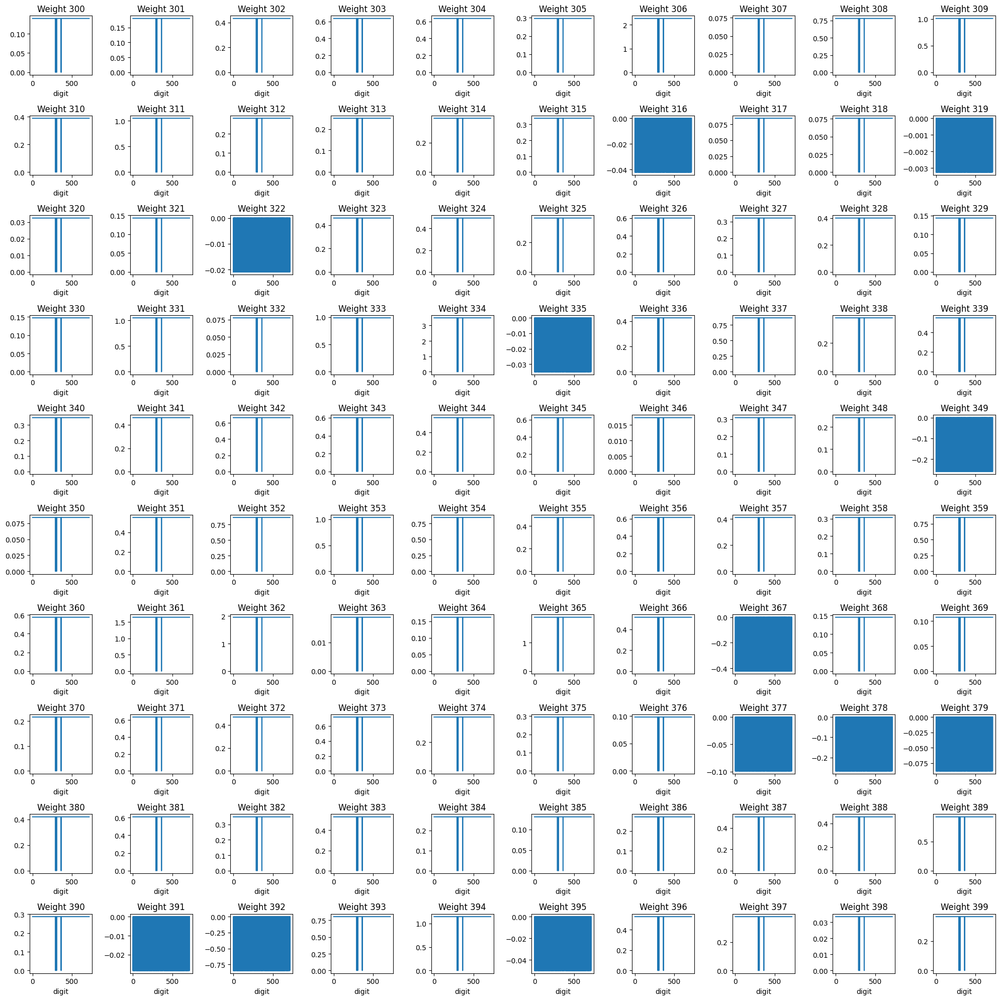

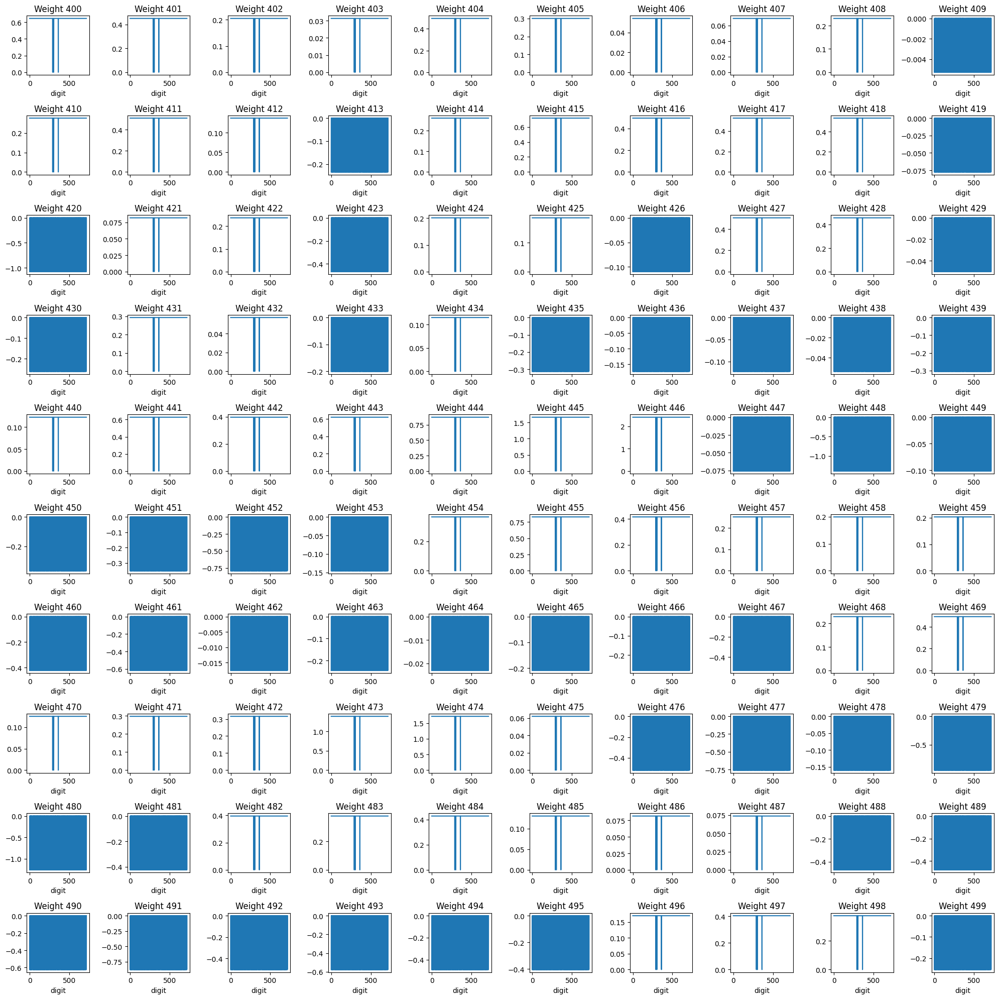

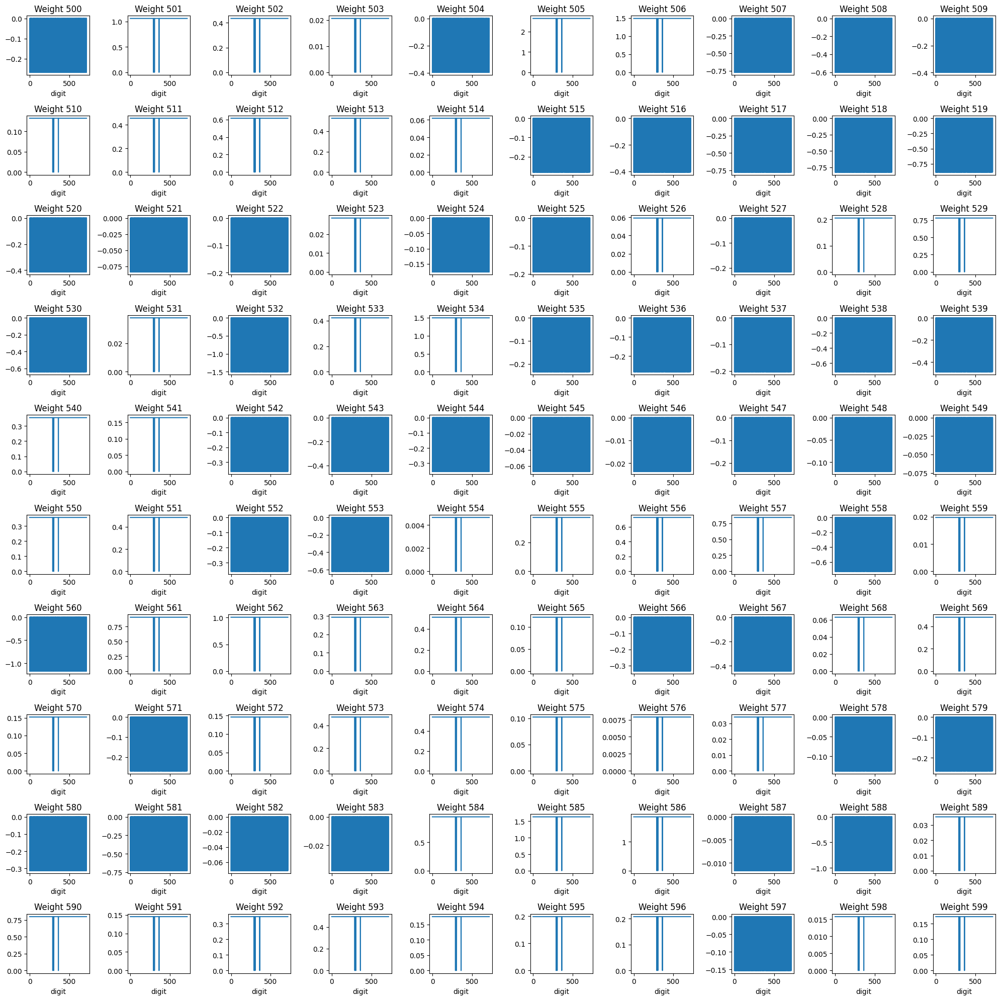

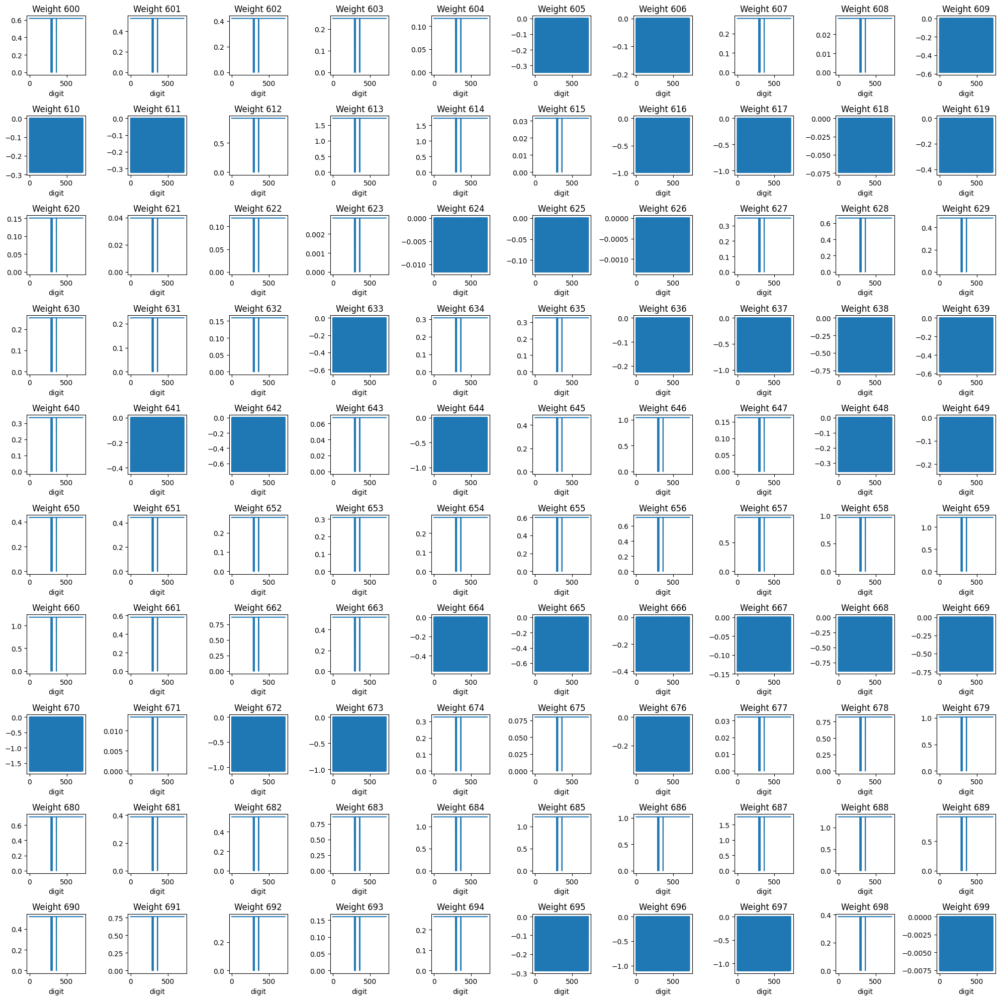

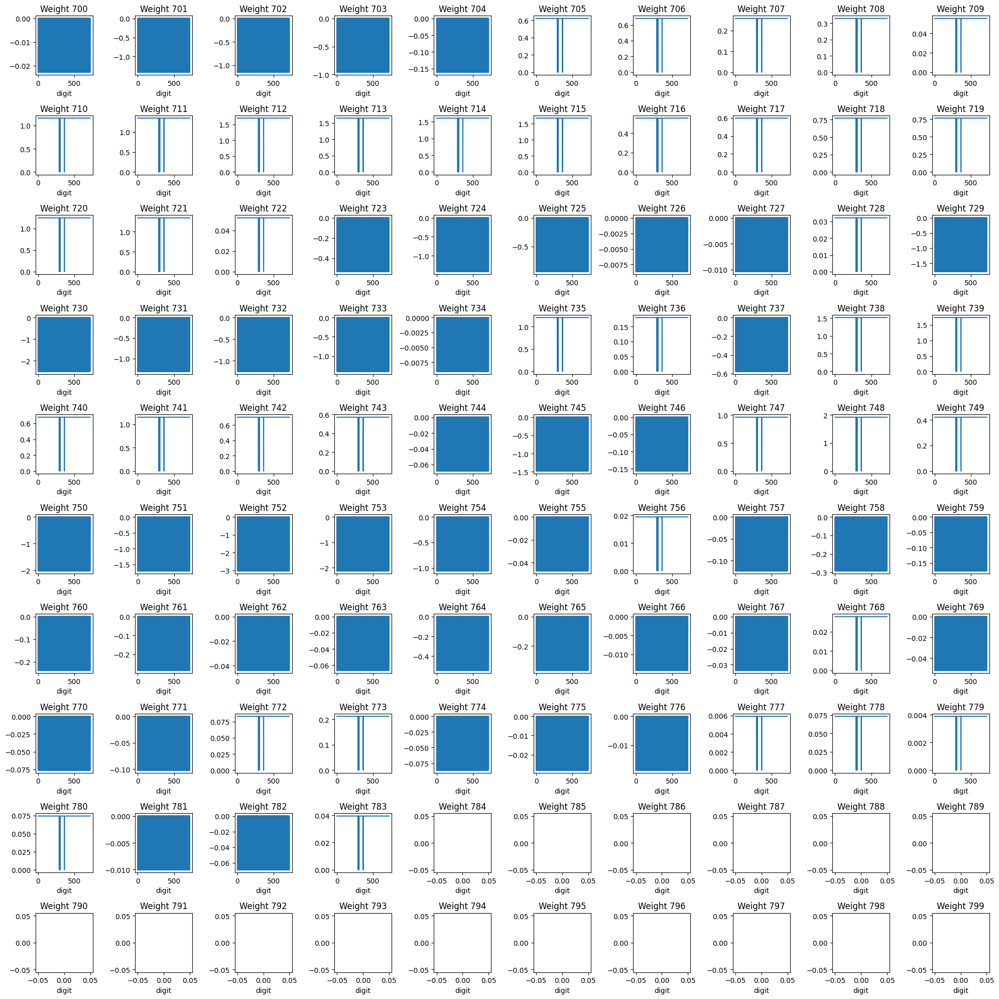

In [58]:
plot_neuron_weights(D1, hz_neuron)
plot_neuron_weights(D1, hz_neuron, pad=100)
plot_neuron_weights(D1, hz_neuron, pad=200)
plot_neuron_weights(D1, hz_neuron, pad=300)
plot_neuron_weights(D1, hz_neuron, pad=400)
plot_neuron_weights(D1, hz_neuron, pad=500)
plot_neuron_weights(D1, hz_neuron, pad=600)
plot_neuron_weights(D1, hz_neuron, pad=700)

- Negative weights keep being reseted due to the sparseness of the output layer (as seen in the Regular Neuron Analysis)
- Positive weights are set to zero when the output is zero, but the sparseness of the output layer bring them back afterwards.

#### Looking closer to one weight

In [59]:
ex_weight = 777

<Axes: xlabel='digit'>

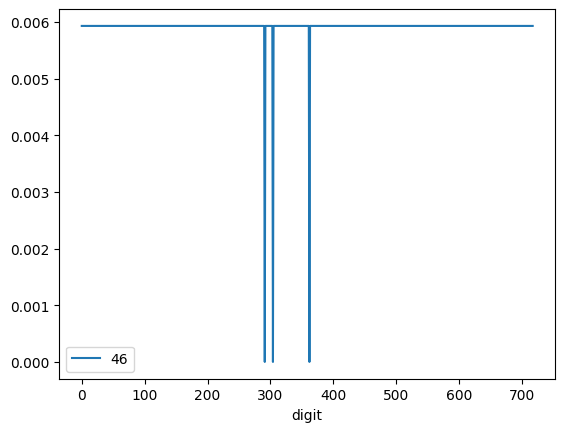

In [60]:
D1[D1.neuron == ex_weight][['digit', str(hz_neuron)]].set_index('digit').plot()

In [61]:
sparse_th = 45

In [62]:
example = (D1[D1.neuron == ex_weight]
            .filter(['digit', str(hz_neuron)])
            .set_index('digit')
            .rename(columns={str(hz_neuron):'updated_weight'})
            .join(  # adding the output of the neuron
                X1[(X1.neuron == hz_neuron)]
                .drop(columns='neuron')
                .set_index('digit')
            )
            .join(  # nonzero weights in the output layer
                D4
                .drop(columns=['neuron'])
                .groupby('digit')
                .apply(pd.DataFrame.drop, columns=['digit'])
                .groupby('digit')
                .apply(np.count_nonzero)
                .map(lambda x: 1 if x < sparse_th else 0)
                .rename('sparse_weights')
            )
        )

In [65]:
example.iloc[285:295]

,updated_weight,output,sparse_weights
digit,,,
285,0.00593,0.176987,1
286,0.00593,0.157455,0
287,0.00593,0.066630,0
288,0.00593,0.064995,1
289,0.00593,0.141854,0
290,0.00593,0.051155,0
291,0.00000,0.000000,1
292,0.00593,0.173053,0
293,0.00593,0.084689,1


At 291, the output is zero. Thus, the updated_weight is set to zero. Nevertheless, in this very iteration, the sparsity of the output layer resets all the weights.

### Selected neurons and Weights

In [66]:
post_ci_df = D1[D1.digit == D1.digit.max()][[str(neuron) for neuron in range(1,49)]].transform(lambda x: x > 0).astype(int).reset_index(drop=True)

In [67]:
post_ci_df

,1,2,3,4,5,6,7,8,9,10,...,39,40,41,42,43,44,45,46,47,48
0,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,1,0,0,0,0,...,0,0,1,1,0,0,0,1,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,1,1,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
779,0,0,0,0,0,1,0,0,1,0,...,0,0,1,0,0,0,0,1,0,0
780,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
781,0,0,0,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0,0,0
782,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0


Text(0.5, 1.0, 'Neurons selected for the module after CI procedure')

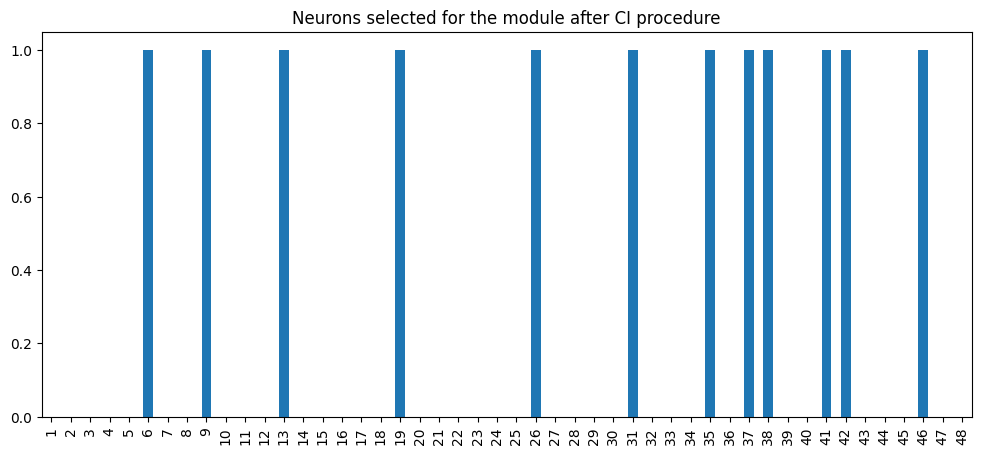

In [68]:
post_ci_df.sum().map(lambda x: 1 if x >= 1 else 0).plot(kind='bar', figsize=(12,5))
plt.title('Neurons selected for the module after CI procedure')

Only 7 neurons were selected during the CI phase of the algorithm.

Text(0.5, 1.0, 'Selected Weights for the module after CI procedure')

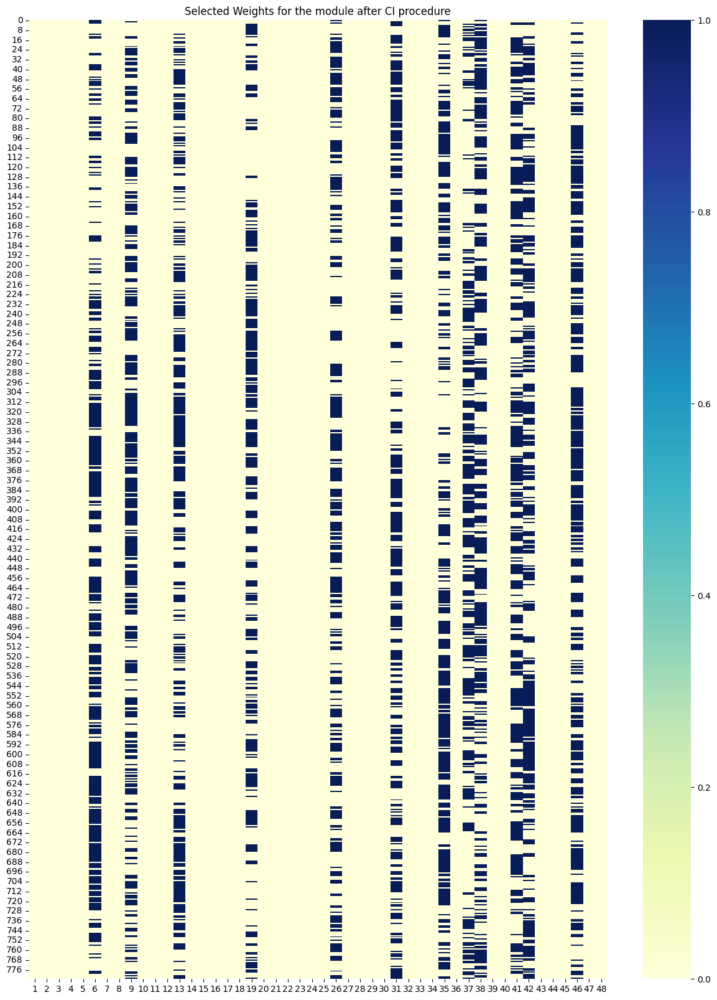

In [69]:
plt.figure(figsize=(15,20))
sns.heatmap(post_ci_df, cmap='YlGnBu', fmt="g")
plt.title('Selected Weights for the module after CI procedure')

From those, only a few weights will be used.

## 2nd Dense layer

Since this layer does not receive the output with the ReLU activation, we have only three possibilities: completely positive outputs, completely negative outputs and mixed.

### Completely positive Outputs

No neurons had this pattern.

### Completely Negative Outputs

In [70]:
r_neuron = 1

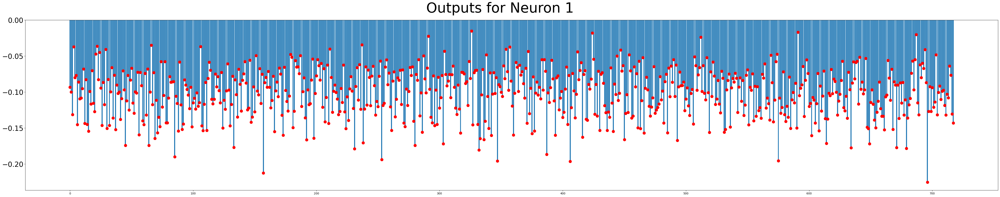

In [71]:
output_rn = X2[X2.neuron == r_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

plt.bar(output_rn.digit, output_rn.output)
plt.scatter(output_rn.digit, output_rn.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {r_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

In [72]:
output_rn.sort_values(by='output', ascending=False)

,output,digit
326,-0.015276,326
591,-0.016690,591
424,-0.017887,424
687,-0.020017,687
291,-0.022287,291
...,...,...
575,-0.195549,575
347,-0.195840,347
406,-0.196317,406
157,-0.212492,157


The highest output was still negative.

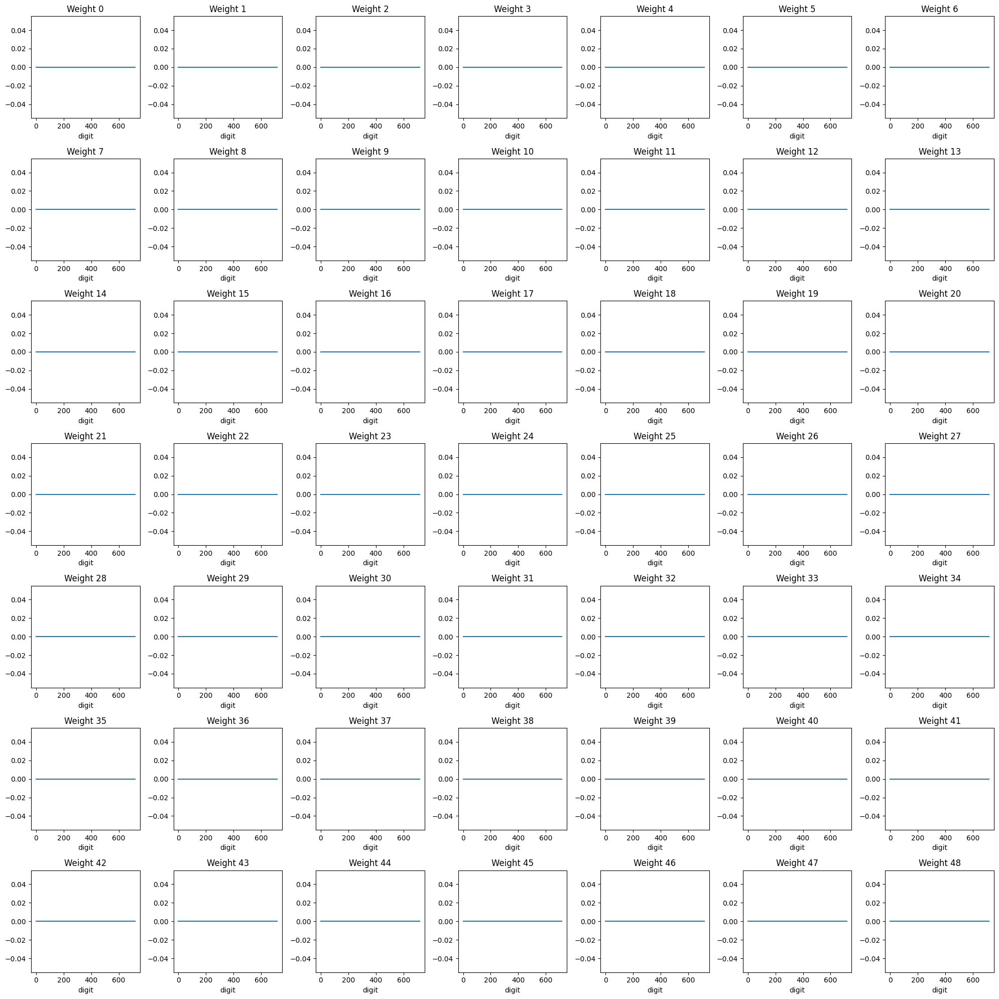

In [75]:
plot_neuron_weights(D2, r_neuron, subplot_sizex=7, subplot_sizey=7)

- Changes are all updated to zero.
    - the very first condition is that if the output is negative, all the weights are zero. Even if the flag is up.  

### Mixed Positive and Negative Outputs

In [108]:
r_neuron = 2

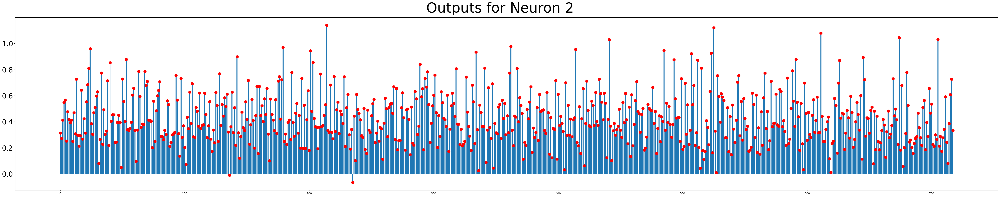

In [109]:
output_rn = X2[X2.neuron == r_neuron][['output', 'digit']].reset_index(drop=True)

fig, axes = plt.subplots(1, 1, figsize=(50, 10), sharex=True)

plt.bar(output_rn.digit, output_rn.output)
plt.scatter(output_rn.digit, output_rn.output, color='red', s=100)

axes.tick_params(axis='y', labelsize=25)

fig.suptitle(f"Outputs for Neuron {r_neuron}", fontsize=50)

# Display the plot
plt.tight_layout()
plt.show()

In [110]:
output_rn.sort_values(by='output', ascending=False)

,output,digit
214,1.139153,214
525,1.118910,525
611,1.079678,611
674,1.044999,674
705,1.031253,705
...,...,...
336,0.024463,336
619,0.013415,619
527,0.009838,527
136,-0.010586,136


This neuron has only two negative output values: one at digit 136 and other at digit 235.

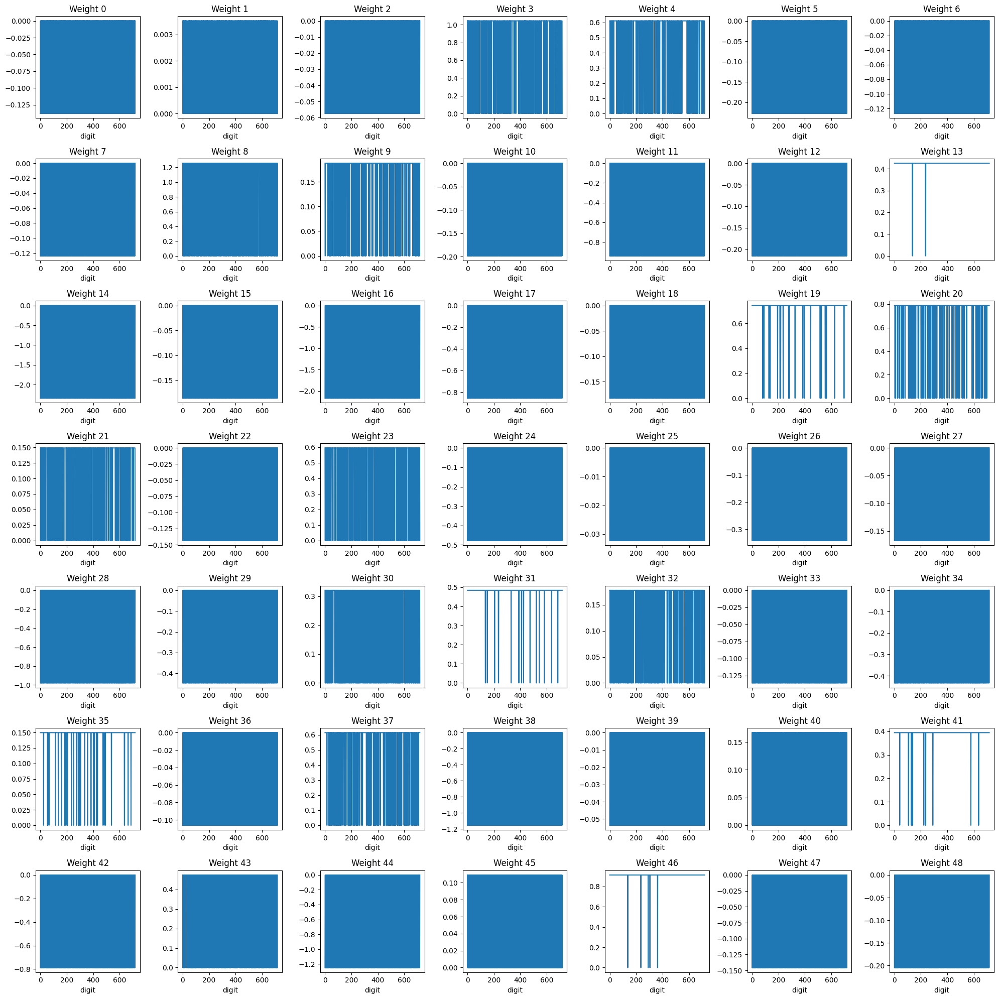

In [80]:
plot_neuron_weights(D2, r_neuron, subplot_sizex=7, subplot_sizey=7)

Differently from the first dense layer, this layer has some differences between the weights update.

#### Weight 13

In [81]:
ex_weight = 13

<Axes: xlabel='digit'>

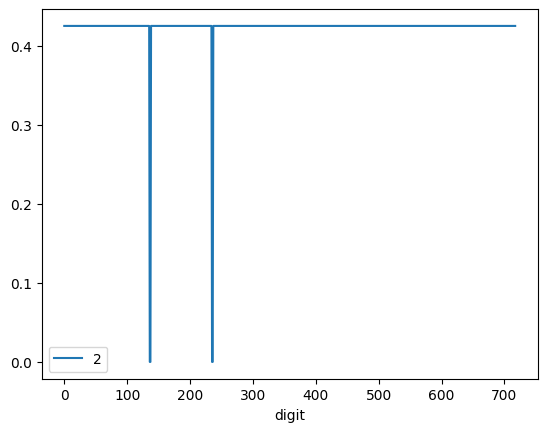

In [82]:
D2[D2.neuron == ex_weight][['digit', str(r_neuron)]].set_index('digit').plot()

In [116]:
sparse_th = 45
example = (D2[D2.neuron == ex_weight]
            .filter(['digit', str(r_neuron)])
            .set_index('digit')
            .rename(columns={str(r_neuron):'updated_weight'})
            
            .join(  # adding the output of the neuron
                X2[(X2.neuron == r_neuron)]
                .drop(columns='neuron')
                .set_index('digit')
                .rename(columns={'output':'output_l2'})
            )

            .join(  # nonzero weights in the output layer
                D4
                .drop(columns=['neuron'])
                .groupby('digit')
                .apply(pd.DataFrame.drop, columns=['digit'])
                .groupby('digit')
                .apply(np.count_nonzero)
                .map(lambda x: 1 if x < sparse_th else 0)
                .rename('sparse_weights')
            )
        )

In [117]:
example.iloc[130:140]

,updated_weight,output_l2,sparse_weights
digit,,,
130,0.425402,0.531210,0
131,0.425402,0.443934,1
132,0.425402,0.583199,0
133,0.425402,0.516995,1
134,0.425402,0.612789,0
135,0.425402,0.320463,1
136,0.000000,-0.010586,0
137,0.000000,0.360579,1
138,0.425402,0.627142,0


In [118]:
example.iloc[230:240]

,updated_weight,output_l2,sparse_weights
digit,,,
230,0.425402,0.508419,0
231,0.425402,0.607662,0
232,0.425402,0.300064,1
233,0.425402,0.191079,0
234,0.425402,0.340652,1
235,0.000000,-0.065273,0
236,0.000000,0.442976,1
237,0.425402,0.102065,0
238,0.425402,0.609126,0


In this case, the weights are updated to zero when the negative output happens. After that, they are reset due to the sparsity of the output layer.

#### Weight 19

In [119]:
ex_weight = 19

<Axes: xlabel='digit'>

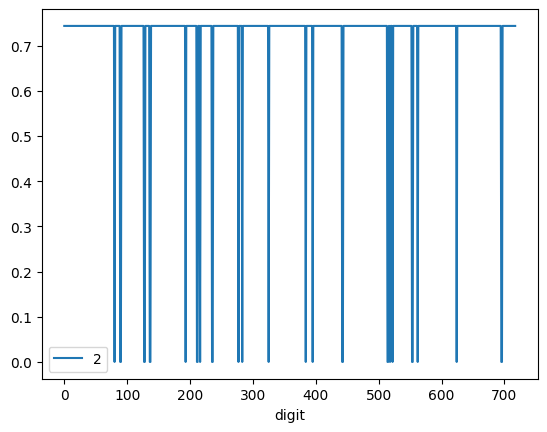

In [120]:
D2[D2.neuron == ex_weight][['digit', str(r_neuron)]].set_index('digit').plot()

In [131]:
D2[D2.neuron == ex_weight][['digit', str(r_neuron)]].set_index('digit').sort_values(by=['2','digit']).head(60)

,2
digit,
80,0.000000
89,0.000000
90,0.000000
127,0.000000
128,0.000000
136,0.000000
137,0.000000
193,0.000000
211,0.000000


For this other weight, besides the negative outputs in 136 and 235, other neurons are also set to zero.
- The code suggests that the output of the 1st layer may have some influence. When the output of a neuron in the first layer is zero, all its weights to the second layer are also set to zero.

```python
if X1[i] <= 0:
    #print("Zero X1")
    self.D1[:,i] = [0 for x in self.D1[:,i]]
    self.D2[i,:]=[0 for x in self.D2[i,:]]
    self.d1[i] = 0
```

In [133]:
sparse_th = 45
example = (D2[D2.neuron == ex_weight]
            .filter(['digit', str(r_neuron)])
            .set_index('digit')
            .rename(columns={str(r_neuron):'updated_weight'})
            
            .join(  # adding the output of the neuron
                X2[(X2.neuron == r_neuron)]
                .drop(columns='neuron')
                .set_index('digit')
                .rename(columns={'output':'output_l2'})
            )
            
            .join(  # adding the output of the neuron
                X1[(X1.neuron == ex_weight)]
                .drop(columns='neuron')
                .set_index('digit')
                .rename(columns={'output':'output_l1'})
            )

            .join(  # nonzero weights in the output layer
                D4
                .drop(columns=['neuron'])
                .groupby('digit')
                .apply(pd.DataFrame.drop, columns=['digit'])
                .groupby('digit')
                .apply(np.count_nonzero)
                .map(lambda x: 1 if x < sparse_th else 0)
                .rename('sparse_weights')
            )
        )

In [135]:
example.iloc[393:398]

,updated_weight,output_l2,output_l1,sparse_weights
digit,,,,
393,0.743547,0.150429,0.058846,1
394,0.743547,0.430667,0.033714,0
395,0.000000,0.123201,0.000000,1
396,0.743547,0.348863,0.053122,0
397,0.743547,0.340660,0.060181,0


In [141]:
example.iloc[78:83]

,updated_weight,output_l2,output_l1,sparse_weights
digit,,,,
78,0.743547,0.598078,0.064089,1
79,0.743547,0.639304,0.083755,0
80,0.000000,0.705399,0.000000,1
81,0.743547,0.288824,0.058163,0
82,0.743547,0.285809,0.085126,0


In [143]:
example.iloc[191:196]

,updated_weight,output_l2,output_l1,sparse_weights
digit,,,,
191,0.743547,0.312937,0.063843,1
192,0.743547,0.448288,0.064269,0
193,0.000000,0.197512,0.000000,1
194,0.743547,0.733596,0.038799,0
195,0.743547,0.194709,0.004625,0


In [145]:
example.iloc[512:517]

,updated_weight,output_l2,output_l1,sparse_weights
digit,,,,
512,0.743547,0.871833,0.041620,1
513,0.743547,0.202008,0.047510,0
514,0.000000,0.042953,0.000000,0
515,0.000000,0.809588,0.116027,1
516,0.743547,0.177796,0.084297,0


In [147]:
example.iloc[622:627]

,updated_weight,output_l2,output_l1,sparse_weights
digit,,,,
622,0.743547,0.578127,0.057704,1
623,0.743547,0.523493,0.068192,0
624,0.000000,0.160669,0.000000,1
625,0.743547,0.695965,0.066265,0
626,0.743547,0.869326,0.111271,1


As we see, the zero output of neuron 19 in the first layer also updates this weight to zero.
- Note that The weights are reset due to the sparsity flag.